### Mini Project 3   

### 1. Data Ingestion

In [1]:
import pandas as pd
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', 100)


A module that was compiled using NumPy 1.x cannot be run in
NumPy 2.2.1 as it may crash. To support both 1.x and 2.x
versions of NumPy, modules must be compiled with NumPy 2.0.
Some module may need to rebuild instead e.g. with 'pybind11>=2.12'.

If you are a user of the module, the easiest solution will be to
downgrade to 'numpy<2' or try to upgrade the affected module.
We expect that some modules will need time to support NumPy 2.

Traceback (most recent call last):  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "C:\Users\User\anaconda3\Lib\site-packages\ipykernel_launcher.py", line 17, in <module>
    app.launch_new_instance()
  File "C:\Users\User\anaconda3\Lib\site-packages\traitlets\config\application.py", line 992, in launch_instance
    app.start()
  File "C:\Users\User\anaconda3\Lib\site-packages\ipykernel\kernelapp.py", line 711, in start
    self.io_loop.start()
  File "C:\Users\User\anaconda3\Lib\site-packages\

AttributeError: _ARRAY_API not found


A module that was compiled using NumPy 1.x cannot be run in
NumPy 2.2.1 as it may crash. To support both 1.x and 2.x
versions of NumPy, modules must be compiled with NumPy 2.0.
Some module may need to rebuild instead e.g. with 'pybind11>=2.12'.

If you are a user of the module, the easiest solution will be to
downgrade to 'numpy<2' or try to upgrade the affected module.
We expect that some modules will need time to support NumPy 2.

Traceback (most recent call last):  File "<frozen runpy>", line 198, in _run_module_as_main
  File "<frozen runpy>", line 88, in _run_code
  File "C:\Users\User\anaconda3\Lib\site-packages\ipykernel_launcher.py", line 17, in <module>
    app.launch_new_instance()
  File "C:\Users\User\anaconda3\Lib\site-packages\traitlets\config\application.py", line 992, in launch_instance
    app.start()
  File "C:\Users\User\anaconda3\Lib\site-packages\ipykernel\kernelapp.py", line 711, in start
    self.io_loop.start()
  File "C:\Users\User\anaconda3\Lib\site-packages\

AttributeError: _ARRAY_API not found

In [2]:
import pandas as pd

# List of files with their respective paths and city names
files= {
    "D:\\AI-ML GUVI\\jaipur_cars.xlsx": "Jaipur",
    "D:\\AI-ML GUVI\\hyderabad_cars.xlsx": "Hyderabad",
    "D:\\AI-ML GUVI\\delhi_cars.xlsx": "Delhi",
    "D:\\AI-ML GUVI\\chennai_cars.xlsx": "Chennai",
    "D:\\AI-ML GUVI\\bangalore_cars.xlsx": "Bangalore",
    "D:\\AI-ML GUVI\\kolkata_cars.xlsx": "Kolkata"
}

# Initialize an empty list to store DataFrames
car_data = []

# Process each file
for file_path, city_name in files.items():
    try:
        # Read the Excel file
        data = pd.read_excel(file_path)
        
        # Add a new column 'City' with the city name
        data['City'] = city_name
        
        # Append the DataFrame to the list
        car_data.append(data)
    except Exception as e:
        print(f"Error processing file {file_path}: {e}")

# Concatenate all DataFrames
combined_dataset = pd.concat(car_data,ignore_index=True)

# Save the combined dataset to a new file
output_path ="combined_cars_dataset.xlsx"
## output_path = "D:\\AI-ML GUVI\\combined_cars_dataset.xlsx"
combined_dataset.to_excel(output_path,index=False)

print(f"Concatenation complete. Combined dataset saved as '{output_path}'")


Concatenation complete. Combined dataset saved as 'combined_cars_dataset.xlsx'


Mean imputation can be used when the distribution of the data is normal, and the missing values are random. Median imputation is appropriate when the distribution of the data is skewed. Mode imputation is used when dealing with categorical data, where the mode represents the most common category.


In [3]:


# Reading an Excel file
df = pd.read_excel('combined_cars_dataset.xlsx')


In [4]:
df.head()

,new_car_detail,new_car_overview,new_car_feature,new_car_specs,car_links,City
0,"{'it': 0, 'ft': 'Diesel', 'bt': 'Hatchback', '...","{'heading': 'Car overview', 'top': [{'key': 'R...","{'heading': 'Features', 'top': [{'value': 'Pow...","{'heading': 'Specifications', 'top': [{'key': ...",https://www.cardekho.com/used-car-details/used...,Jaipur
1,"{'it': 0, 'ft': 'Petrol', 'bt': 'Hatchback', '...","{'heading': 'Car overview', 'top': [{'key': 'R...","{'heading': 'Features', 'top': [{'value': 'Pow...","{'heading': 'Specifications', 'top': [{'key': ...",https://www.cardekho.com/buy-used-car-details/...,Jaipur
2,"{'it': 0, 'ft': 'Petrol', 'bt': 'Hatchback', '...","{'heading': 'Car overview', 'top': [{'key': 'R...","{'heading': 'Features', 'top': [{'value': 'Pow...","{'heading': 'Specifications', 'top': [{'key': ...",https://www.cardekho.com/used-car-details/used...,Jaipur
3,"{'it': 0, 'ft': 'Petrol', 'bt': 'Hatchback', '...","{'heading': 'Car overview', 'top': [{'key': 'R...","{'heading': 'Features', 'top': [{'value': 'Pow...","{'heading': 'Specifications', 'top': [{'key': ...",https://www.cardekho.com/buy-used-car-details/...,Jaipur
4,"{'it': 0, 'ft': 'Petrol', 'bt': 'Hatchback', '...","{'heading': 'Car overview', 'top': [{'key': 'R...","{'heading': 'Features', 'top': [{'value': 'Pow...","{'heading': 'Specifications', 'top': [{'key': ...",https://www.cardekho.com/used-car-details/used...,Jaipur


In [5]:
df.shape

(8369, 6)

In [6]:
#### The given dataset comprises of 8369 instances with 6 features

#### Four of them are descripters containing dictionaries. 

### 2. Data Cleaning and Feature Extraction

In [7]:
#Checking the type of the first value in 1st column
print(type(df.iloc[0, 1]))

<class 'str'>


In [8]:
df['new_car_detail'] =df['new_car_detail'].fillna('{}')

In [9]:
df["Expanded"] = df["new_car_detail"].apply(lambda x : dict(eval(x)) )
new_car_details_df = df["Expanded"].apply(pd.Series )


In [10]:
new_car_details_df.head(20)

,it,ft,bt,km,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,price,priceActual,priceSaving,priceFixedText,trendingText
0,0,Diesel,Hatchback,"1,20,000",Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,₹ 5.10 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...
1,0,Petrol,Hatchback,"66,951",Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,₹ 3.81 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...
2,0,Petrol,Hatchback,"80,000",Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,₹ 3.20 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...
3,0,Petrol,Hatchback,"44,392",Manual,1,1st Owner,Hyundai,Hyundai Grand i10,2017,5602,1.2 Kappa Magna BSIV,₹ 4.20 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...
4,0,Petrol,Hatchback,"40,000",Automatic,1,1st Owner,Maruti,Maruti Wagon R,2016,4319,AMT VXI,₹ 3.50 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...
5,0,Diesel,Sedan,"1,50,000",Manual,2,2nd Owner,Hyundai,Hyundai Verna,2007,1796,CRDi,₹ 1.50 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...
6,0,Petrol,Sedan,"91,771",Manual,2,2nd Owner,Hyundai,Hyundai Xcent,2016,1861,1.2 Kappa S Celebration Edition,₹ 4.89 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...
7,0,Diesel,Sedan,"90,000",Automatic,1,1st Owner,Skoda,Skoda Superb,2011,3217,Elegance 2.0 TDI CR AT,₹ 4.25 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...
8,0,Diesel,SUV,"58,621",Automatic,1,1st Owner,BMW,BMW X1,2014,345,sDrive20d,₹ 13.75 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...
9,0,Diesel,Sedan,"90,000",Automatic,1,1st Owner,Skoda,Skoda Superb,2011,3217,Elegance 2.0 TDI CR AT,₹ 4.50 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...


In [11]:
new_car_details_df['Price(in Lakhs)'] =new_car_details_df['price'].apply(lambda x: x[2:7])

In [12]:
new_car_details_df['Price(in Lakhs)'] =new_car_details_df['Price(in Lakhs)'].apply(lambda x: x.split()[0])

In [13]:
new_car_details_df.head()

,it,ft,bt,km,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,price,priceActual,priceSaving,priceFixedText,trendingText,Price(in Lakhs)
0,0,Diesel,Hatchback,"1,20,000",Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,₹ 5.10 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,5.10
1,0,Petrol,Hatchback,"66,951",Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,₹ 3.81 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,3.81
2,0,Petrol,Hatchback,"80,000",Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,₹ 3.20 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,3.20
3,0,Petrol,Hatchback,"44,392",Manual,1,1st Owner,Hyundai,Hyundai Grand i10,2017,5602,1.2 Kappa Magna BSIV,₹ 4.20 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,4.20
4,0,Petrol,Hatchback,"40,000",Automatic,1,1st Owner,Maruti,Maruti Wagon R,2016,4319,AMT VXI,₹ 3.50 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,3.50


In [14]:
values =list(new_car_details_df['Price(in Lakhs)'].unique())

In [15]:
for v in values:
    print(v)

5.10
3.81
3.20
4.20
3.50
1.50
4.89
4.25
13.75
4.50
4.49
2.95
58.90
1.05
19.90
4.75
20
9
9.50
19
4.36
10
2.52
6.85
5.50
6.99
7.50
3.25
13
22.50
46
3.75
5.60
5.90
5.55
42
60,00
6
1.70
3.43
5.44
9.90
4.69
7.16
3.05
2.90
2.10
9.10
2.25
7.25
5.70
12
7.21
7.75
7.40
7.32
6.50
8.50
16.50
21.50
5
2.50
14.73
1.75
6.90
7.14
26.80
4.92
4.01
17
5.25
1.30
11.50
9.34
3.60
7.10
21.90
11
6.25
4.96
8.99
6.75
8.30
4.70
90
6.65
18.50
1.20
1.42
5.75
3.21
6.80
8.25
3.96
7.42
8.51
8.40
9.70
7
9.15
4
5.40
6.40
7.98
3.85
4.85
5.28
5.45
8.35
6.35
6.21
9.80
31.90
13.95
4.53
5.34
6.10
7.09
8.90
10.10
7.90
8.88
6.95
10.60
23.90
25
7.23
7.95
10.20
2
14.25
17.90
6.30
14.50
2.85
5.35
4.35
2.30
5.74
5.89
3.77
8.70
24.90
1.80
8
15
2.70
4.10
6.92
4.80
10.25
36
17.50
13.25
2.65
1
6.34
4.58
9.40
3.27
4.59
13.90
1.60
4.45
15.25
3.90
29.90
4.46
6.72
4.09
7.59
6.70
11.95
14.90
3.11
7.01
3.71
54
3.49
30
27.50
3.62
4.55
3.80
8.15
14
3.30
8.11
8.95
3
18.90
5.79
2.98
5.95
2.44
15.55
3.70
7.53
5.87
5.80
5.30
15.95
1.90
3.83
7.13


In [16]:
new_car_details_df['Price(in Lakhs)'] =new_car_details_df['Price(in Lakhs)'].apply(lambda x: x.replace(',', '.') if ',' in x else x)

In [17]:
new_car_details_df.head()

,it,ft,bt,km,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,price,priceActual,priceSaving,priceFixedText,trendingText,Price(in Lakhs)
0,0,Diesel,Hatchback,"1,20,000",Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,₹ 5.10 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,5.10
1,0,Petrol,Hatchback,"66,951",Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,₹ 3.81 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,3.81
2,0,Petrol,Hatchback,"80,000",Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,₹ 3.20 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,3.20
3,0,Petrol,Hatchback,"44,392",Manual,1,1st Owner,Hyundai,Hyundai Grand i10,2017,5602,1.2 Kappa Magna BSIV,₹ 4.20 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,4.20
4,0,Petrol,Hatchback,"40,000",Automatic,1,1st Owner,Maruti,Maruti Wagon R,2016,4319,AMT VXI,₹ 3.50 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,3.50


In [18]:
values =list(new_car_details_df['Price(in Lakhs)'].unique())

In [19]:
for v in values:
    print(v)

5.10
3.81
3.20
4.20
3.50
1.50
4.89
4.25
13.75
4.50
4.49
2.95
58.90
1.05
19.90
4.75
20
9
9.50
19
4.36
10
2.52
6.85
5.50
6.99
7.50
3.25
13
22.50
46
3.75
5.60
5.90
5.55
42
60.00
6
1.70
3.43
5.44
9.90
4.69
7.16
3.05
2.90
2.10
9.10
2.25
7.25
5.70
12
7.21
7.75
7.40
7.32
6.50
8.50
16.50
21.50
5
2.50
14.73
1.75
6.90
7.14
26.80
4.92
4.01
17
5.25
1.30
11.50
9.34
3.60
7.10
21.90
11
6.25
4.96
8.99
6.75
8.30
4.70
90
6.65
18.50
1.20
1.42
5.75
3.21
6.80
8.25
3.96
7.42
8.51
8.40
9.70
7
9.15
4
5.40
6.40
7.98
3.85
4.85
5.28
5.45
8.35
6.35
6.21
9.80
31.90
13.95
4.53
5.34
6.10
7.09
8.90
10.10
7.90
8.88
6.95
10.60
23.90
25
7.23
7.95
10.20
2
14.25
17.90
6.30
14.50
2.85
5.35
4.35
2.30
5.74
5.89
3.77
8.70
24.90
1.80
8
15
2.70
4.10
6.92
4.80
10.25
36
17.50
13.25
2.65
1
6.34
4.58
9.40
3.27
4.59
13.90
1.60
4.45
15.25
3.90
29.90
4.46
6.72
4.09
7.59
6.70
11.95
14.90
3.11
7.01
3.71
54
3.49
30
27.50
3.62
4.55
3.80
8.15
14
3.30
8.11
8.95
3
18.90
5.79
2.98
5.95
2.44
15.55
3.70
7.53
5.87
5.80
5.30
15.95
1.90
3.83
7.13


In [20]:
new_car_details_df.columns

Index(['it', 'ft', 'bt', 'km', 'transmission', 'ownerNo', 'owner', 'oem',
       'model', 'modelYear', 'centralVariantId', 'variantName', 'price',
       'priceActual', 'priceSaving', 'priceFixedText', 'trendingText',
       'Price(in Lakhs)'],
      dtype='object')

In [21]:
new_car_details_df['priceActual'].unique()

array(['', '₹ 5.55 Lakh', '₹ 7.17 Lakh', '₹ 8 Lakh', '₹ 7.73 Lakh',
       '₹ 7.44 Lakh', '₹ 5.17 Lakh', '₹ 5.37 Lakh', '₹ 9.15 Lakh',
       '₹ 3.34 Lakh', '₹ 7.56 Lakh', '₹ 7.57 Lakh', '₹ 6.64 Lakh',
       '₹ 8.55 Lakh', '₹ 5.10 Lakh', '₹ 5.72 Lakh', '₹ 4.62 Lakh',
       '₹ 7.38 Lakh', '₹ 6.37 Lakh', '₹ 6.46 Lakh', '₹ 7.07 Lakh',
       '₹ 5.20 Lakh', '₹ 7.48 Lakh', '₹ 5.51 Lakh', '₹ 6.60 Lakh',
       '₹ 4.81 Lakh', '₹ 3.93 Lakh', '₹ 4.68 Lakh', '₹ 7.47 Lakh',
       '₹ 4.38 Lakh', '₹ 7.90 Lakh', '₹ 7.53 Lakh', '₹ 4.09 Lakh',
       '₹ 4.21 Lakh', '₹ 4.83 Lakh', '₹ 4.43 Lakh', '₹ 5.35 Lakh',
       '₹ 4.04 Lakh', '₹ 8.68 Lakh', '₹ 6.03 Lakh', '₹ 3.28 Lakh',
       '₹ 5.89 Lakh', '₹ 9.39 Lakh', '₹ 7.60 Lakh', '₹ 6.52 Lakh',
       '₹ 6.82 Lakh', '₹ 3.99 Lakh', '₹ 7.75 Lakh', '₹ 3.41 Lakh',
       '₹ 4.12 Lakh', '₹ 3.70 Lakh', '₹ 3.55 Lakh', '₹ 6.20 Lakh',
       '₹ 8.11 Lakh', '₹ 16.18 Lakh', '₹ 5.66 Lakh', '₹ 7.62 Lakh',
       '₹ 3.63 Lakh', '₹ 3.89 Lakh', '₹ 5.06 Lakh', '₹ 9.85 

In [22]:
new_car_details_df['Actual_Price'] = new_car_details_df['priceActual'].apply(lambda x: x[2:6]  if x!=''  else x)

In [23]:
new_car_details_df['Actual_Price'].unique()

array(['', '5.55', '7.17', '8 La', '7.73', '7.44', '5.17', '5.37', '9.15',
       '3.34', '7.56', '7.57', '6.64', '8.55', '5.10', '5.72', '4.62',
       '7.38', '6.37', '6.46', '7.07', '5.20', '7.48', '5.51', '6.60',
       '4.81', '3.93', '4.68', '7.47', '4.38', '7.90', '7.53', '4.09',
       '4.21', '4.83', '4.43', '5.35', '4.04', '8.68', '6.03', '3.28',
       '5.89', '9.39', '7.60', '6.52', '6.82', '3.99', '7.75', '3.41',
       '4.12', '3.70', '3.55', '6.20', '8.11', '16.1', '5.66', '7.62',
       '3.63', '3.89', '5.06', '9.85', '3.09', '3.31', '4.03', '2.69',
       '3.44', '3.50', '2.79', '5.53', '15.8', '8.67', '3.43', '4.88',
       '4.55', '15.7', '3.47', '2.48', '3.68', '5.42', '3.26', '4.26',
       '2.77', '4.33', '6.59', '6.83', '8.74', '14.2', '3.77', '4.15',
       '4.74', '7.76', '8.43', '5.58', '4.50', '3.86', '2.99', '5.88',
       '6.44', '6.35', '9.70', '11.5', '3.90', '3.65', '5.47', '7.55',
       '5.62', '6.80', '5.84', '5.07', '6.57', '2.25', '12.2', '4.95',
  

In [24]:
new_car_details_df['Actual_Price'] =new_car_details_df['Actual_Price'].apply(lambda x: x[0] if str(x).endswith('La') else x)

In [25]:
new_car_details_df['Actual_Price'].unique()

array(['', '5.55', '7.17', '8', '7.73', '7.44', '5.17', '5.37', '9.15',
       '3.34', '7.56', '7.57', '6.64', '8.55', '5.10', '5.72', '4.62',
       '7.38', '6.37', '6.46', '7.07', '5.20', '7.48', '5.51', '6.60',
       '4.81', '3.93', '4.68', '7.47', '4.38', '7.90', '7.53', '4.09',
       '4.21', '4.83', '4.43', '5.35', '4.04', '8.68', '6.03', '3.28',
       '5.89', '9.39', '7.60', '6.52', '6.82', '3.99', '7.75', '3.41',
       '4.12', '3.70', '3.55', '6.20', '8.11', '16.1', '5.66', '7.62',
       '3.63', '3.89', '5.06', '9.85', '3.09', '3.31', '4.03', '2.69',
       '3.44', '3.50', '2.79', '5.53', '15.8', '8.67', '3.43', '4.88',
       '4.55', '15.7', '3.47', '2.48', '3.68', '5.42', '3.26', '4.26',
       '2.77', '4.33', '6.59', '6.83', '8.74', '14.2', '3.77', '4.15',
       '4.74', '7.76', '8.43', '5.58', '4.50', '3.86', '2.99', '5.88',
       '6.44', '6.35', '9.70', '11.5', '3.90', '3.65', '5.47', '7.55',
       '5.62', '6.80', '5.84', '5.07', '6.57', '2.25', '12.2', '4.95',
     

In [26]:
new_car_details_df.head()

,it,ft,bt,km,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,price,priceActual,priceSaving,priceFixedText,trendingText,Price(in Lakhs),Actual_Price
0,0,Diesel,Hatchback,"1,20,000",Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,₹ 5.10 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,5.10,
1,0,Petrol,Hatchback,"66,951",Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,₹ 3.81 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,3.81,
2,0,Petrol,Hatchback,"80,000",Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,₹ 3.20 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,3.20,
3,0,Petrol,Hatchback,"44,392",Manual,1,1st Owner,Hyundai,Hyundai Grand i10,2017,5602,1.2 Kappa Magna BSIV,₹ 4.20 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,4.20,
4,0,Petrol,Hatchback,"40,000",Automatic,1,1st Owner,Maruti,Maruti Wagon R,2016,4319,AMT VXI,₹ 3.50 Lakh,,,None,{'imgUrl': 'https://stimg.cardekho.com/used-ca...,3.50,


In [27]:
new_car_details_df.columns

Index(['it', 'ft', 'bt', 'km', 'transmission', 'ownerNo', 'owner', 'oem',
       'model', 'modelYear', 'centralVariantId', 'variantName', 'price',
       'priceActual', 'priceSaving', 'priceFixedText', 'trendingText',
       'Price(in Lakhs)', 'Actual_Price'],
      dtype='object')

In [28]:
new_car_details_df['priceSaving'].unique()

array([''], dtype=object)

In [29]:
new_car_details_df['priceFixedText'].unique()


array([None], dtype=object)

In [30]:
new_car_details_df['trendingText'][:3]

0    {'imgUrl': 'https://stimg.cardekho.com/used-ca...
1    {'imgUrl': 'https://stimg.cardekho.com/used-ca...
2    {'imgUrl': 'https://stimg.cardekho.com/used-ca...
Name: trendingText, dtype: object

####  We will drop columns 'it', 'priceSaving', and text related features as they are irrelevent for price prediction

In [31]:
new_car_details_df.drop(columns =['it', 'priceSaving','priceFixedText', 'trendingText'], inplace=True)

In [32]:
new_car_details_df.head(20)

,ft,bt,km,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,price,priceActual,Price(in Lakhs),Actual_Price
0,Diesel,Hatchback,"1,20,000",Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,₹ 5.10 Lakh,,5.10,
1,Petrol,Hatchback,"66,951",Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,₹ 3.81 Lakh,,3.81,
2,Petrol,Hatchback,"80,000",Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,₹ 3.20 Lakh,,3.20,
3,Petrol,Hatchback,"44,392",Manual,1,1st Owner,Hyundai,Hyundai Grand i10,2017,5602,1.2 Kappa Magna BSIV,₹ 4.20 Lakh,,4.20,
4,Petrol,Hatchback,"40,000",Automatic,1,1st Owner,Maruti,Maruti Wagon R,2016,4319,AMT VXI,₹ 3.50 Lakh,,3.50,
5,Diesel,Sedan,"1,50,000",Manual,2,2nd Owner,Hyundai,Hyundai Verna,2007,1796,CRDi,₹ 1.50 Lakh,,1.50,
6,Petrol,Sedan,"91,771",Manual,2,2nd Owner,Hyundai,Hyundai Xcent,2016,1861,1.2 Kappa S Celebration Edition,₹ 4.89 Lakh,,4.89,
7,Diesel,Sedan,"90,000",Automatic,1,1st Owner,Skoda,Skoda Superb,2011,3217,Elegance 2.0 TDI CR AT,₹ 4.25 Lakh,,4.25,
8,Diesel,SUV,"58,621",Automatic,1,1st Owner,BMW,BMW X1,2014,345,sDrive20d,₹ 13.75 Lakh,,13.75,
9,Diesel,Sedan,"90,000",Automatic,1,1st Owner,Skoda,Skoda Superb,2011,3217,Elegance 2.0 TDI CR AT,₹ 4.50 Lakh,,4.50,


In [33]:
new_car_details_df['Distance(in KM)'] = new_car_details_df['km'].apply(lambda x: x.replace(',', ''))

In [34]:
new_car_details_df.head(10)

,ft,bt,km,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,price,priceActual,Price(in Lakhs),Actual_Price,Distance(in KM)
0,Diesel,Hatchback,"1,20,000",Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,₹ 5.10 Lakh,,5.10,,120000
1,Petrol,Hatchback,"66,951",Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,₹ 3.81 Lakh,,3.81,,66951
2,Petrol,Hatchback,"80,000",Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,₹ 3.20 Lakh,,3.20,,80000
3,Petrol,Hatchback,"44,392",Manual,1,1st Owner,Hyundai,Hyundai Grand i10,2017,5602,1.2 Kappa Magna BSIV,₹ 4.20 Lakh,,4.20,,44392
4,Petrol,Hatchback,"40,000",Automatic,1,1st Owner,Maruti,Maruti Wagon R,2016,4319,AMT VXI,₹ 3.50 Lakh,,3.50,,40000
5,Diesel,Sedan,"1,50,000",Manual,2,2nd Owner,Hyundai,Hyundai Verna,2007,1796,CRDi,₹ 1.50 Lakh,,1.50,,150000
6,Petrol,Sedan,"91,771",Manual,2,2nd Owner,Hyundai,Hyundai Xcent,2016,1861,1.2 Kappa S Celebration Edition,₹ 4.89 Lakh,,4.89,,91771
7,Diesel,Sedan,"90,000",Automatic,1,1st Owner,Skoda,Skoda Superb,2011,3217,Elegance 2.0 TDI CR AT,₹ 4.25 Lakh,,4.25,,90000
8,Diesel,SUV,"58,621",Automatic,1,1st Owner,BMW,BMW X1,2014,345,sDrive20d,₹ 13.75 Lakh,,13.75,,58621
9,Diesel,Sedan,"90,000",Automatic,1,1st Owner,Skoda,Skoda Superb,2011,3217,Elegance 2.0 TDI CR AT,₹ 4.50 Lakh,,4.50,,90000


In [35]:
new_car_details_df.drop(columns =['km','price', 'priceActual'], inplace=True)
new_car_details_df.head(3)

,ft,bt,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,Price(in Lakhs),Actual_Price,Distance(in KM)
0,Diesel,Hatchback,Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,5.10,,120000
1,Petrol,Hatchback,Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,3.81,,66951
2,Petrol,Hatchback,Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,3.20,,80000


In [36]:
new_car_details_df['Actual_Price'].unique()

array(['', '5.55', '7.17', '8', '7.73', '7.44', '5.17', '5.37', '9.15',
       '3.34', '7.56', '7.57', '6.64', '8.55', '5.10', '5.72', '4.62',
       '7.38', '6.37', '6.46', '7.07', '5.20', '7.48', '5.51', '6.60',
       '4.81', '3.93', '4.68', '7.47', '4.38', '7.90', '7.53', '4.09',
       '4.21', '4.83', '4.43', '5.35', '4.04', '8.68', '6.03', '3.28',
       '5.89', '9.39', '7.60', '6.52', '6.82', '3.99', '7.75', '3.41',
       '4.12', '3.70', '3.55', '6.20', '8.11', '16.1', '5.66', '7.62',
       '3.63', '3.89', '5.06', '9.85', '3.09', '3.31', '4.03', '2.69',
       '3.44', '3.50', '2.79', '5.53', '15.8', '8.67', '3.43', '4.88',
       '4.55', '15.7', '3.47', '2.48', '3.68', '5.42', '3.26', '4.26',
       '2.77', '4.33', '6.59', '6.83', '8.74', '14.2', '3.77', '4.15',
       '4.74', '7.76', '8.43', '5.58', '4.50', '3.86', '2.99', '5.88',
       '6.44', '6.35', '9.70', '11.5', '3.90', '3.65', '5.47', '7.55',
       '5.62', '6.80', '5.84', '5.07', '6.57', '2.25', '12.2', '4.95',
     

In [37]:




new_car_details_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8369 entries, 0 to 8368
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   ft                8369 non-null   object
 1   bt                8369 non-null   object
 2   transmission      8369 non-null   object
 3   ownerNo           8369 non-null   int64 
 4   owner             8369 non-null   object
 5   oem               8369 non-null   object
 6   model             8369 non-null   object
 7   modelYear         8369 non-null   int64 
 8   centralVariantId  8369 non-null   int64 
 9   variantName       8369 non-null   object
 10  Price(in Lakhs)   8369 non-null   object
 11  Actual_Price      8369 non-null   object
 12  Distance(in KM)   8369 non-null   object
dtypes: int64(3), object(10)
memory usage: 850.1+ KB


In [38]:
object_type_features=[]
for feature in new_car_details_df.columns:
    if new_car_details_df[feature].dtype=='object':
        object_type_features.append(feature)
        

In [39]:
object_type_features

['ft',
 'bt',
 'transmission',
 'owner',
 'oem',
 'model',
 'variantName',
 'Price(in Lakhs)',
 'Actual_Price',
 'Distance(in KM)']

In [40]:
new_car_details_df[new_car_details_df["Actual_Price"]=='3 La']

,ft,bt,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,Price(in Lakhs),Actual_Price,Distance(in KM)


In [41]:
new_car_details_df["Actual_Price"] = new_car_details_df["Actual_Price"].apply(lambda x: 10 if x =='10 L' else x)

* We need to convert Price and Actual Price into float type

In [42]:
new_car_details_df[['Price(in Lakhs)', 'Actual_Price']] = new_car_details_df[['Price(in Lakhs)', 'Actual_Price']].apply(pd.to_numeric)

In [43]:
new_car_details_df.head()

,ft,bt,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,Price(in Lakhs),Actual_Price,Distance(in KM)
0,Diesel,Hatchback,Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,5.10,NaN,120000
1,Petrol,Hatchback,Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,3.81,NaN,66951
2,Petrol,Hatchback,Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,3.20,NaN,80000
3,Petrol,Hatchback,Manual,1,1st Owner,Hyundai,Hyundai Grand i10,2017,5602,1.2 Kappa Magna BSIV,4.20,NaN,44392
4,Petrol,Hatchback,Automatic,1,1st Owner,Maruti,Maruti Wagon R,2016,4319,AMT VXI,3.50,NaN,40000


In [44]:
new_car_details_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8369 entries, 0 to 8368
Data columns (total 13 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   ft                8369 non-null   object 
 1   bt                8369 non-null   object 
 2   transmission      8369 non-null   object 
 3   ownerNo           8369 non-null   int64  
 4   owner             8369 non-null   object 
 5   oem               8369 non-null   object 
 6   model             8369 non-null   object 
 7   modelYear         8369 non-null   int64  
 8   centralVariantId  8369 non-null   int64  
 9   variantName       8369 non-null   object 
 10  Price(in Lakhs)   8369 non-null   float64
 11  Actual_Price      1670 non-null   float64
 12  Distance(in KM)   8369 non-null   object 
dtypes: float64(2), int64(3), object(8)
memory usage: 850.1+ KB


In [45]:
# Replace 'your_dataframe' with your actual DataFrame name

# Remove non-numeric characters (if any) and convert to integer
new_car_details_df['Distance(in KM)'] = (new_car_details_df['Distance(in KM)'].astype('str').str.replace(',', '').astype(int) )

new_car_details_df['Price(in Lakhs)'] = (new_car_details_df['Price(in Lakhs)'].astype('str').str.replace(',', '').astype(float) )
print(new_car_details_df.dtypes)


ft                   object
bt                   object
transmission         object
ownerNo               int64
owner                object
oem                  object
model                object
modelYear             int64
centralVariantId      int64
variantName          object
Price(in Lakhs)     float64
Actual_Price        float64
Distance(in KM)       int64
dtype: object


In [46]:
new_car_details_df.head(3)

,ft,bt,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,Price(in Lakhs),Actual_Price,Distance(in KM)
0,Diesel,Hatchback,Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,5.10,NaN,120000
1,Petrol,Hatchback,Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,3.81,NaN,66951
2,Petrol,Hatchback,Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,3.20,NaN,80000


In [47]:
#### Let us inspect other two columns where we see nested dictionries from original df

In [48]:
df['new_car_overview'].unique()[:1]

array(["{'heading': 'Car overview', 'top': [{'key': 'Registration Year', 'value': '2015', 'icon': 'https://images10.gaadi.com/listing/vdp/co/v1/registrationYear.svg'}, {'key': 'Insurance Validity', 'value': 'Third Party insurance', 'icon': 'https://images10.gaadi.com/listing/vdp/co/v1/insuranceValidity.svg'}, {'key': 'Fuel Type', 'value': 'Diesel', 'icon': 'https://images10.gaadi.com/listing/vdp/co/v1/fuel.svg'}, {'key': 'Seats', 'value': '5 Seats', 'icon': 'https://images10.gaadi.com/listing/vdp/co/v1/seats.svg'}, {'key': 'Kms Driven', 'value': '1,20,000 Kms', 'icon': 'https://images10.gaadi.com/listing/vdp/co/v1/kmsDriven.svg'}, {'key': 'RTO', 'value': 'RJ13', 'icon': 'https://images10.gaadi.com/listing/vdp/co/v1/rto.svg'}, {'key': 'Ownership', 'value': 'Second Owner', 'icon': 'https://images10.gaadi.com/listing/vdp/co/v1/ownership.svg'}, {'key': 'Engine Displacement', 'value': '1396 cc', 'icon': 'https://images10.gaadi.com/listing/vdp/co/v1/engineDisplacement.svg'}, {'key': 'Transmi

In [49]:
import pandas as pd
import ast

# Extract the JSON-like string from the DataFrame
data_str = df['new_car_overview'].unique()[0]  # Taking first unique value

# Convert string to dictionary
data_dict = ast.literal_eval(data_str)  

# Convert 'top' section to a DataFrame
top_df = pd.DataFrame(data_dict['top'])

# Extract values
seats = top_df.loc[top_df['key'] == 'Seats', 'value'].values[0].split()[0]
engine_capacity = top_df.loc[top_df['key'] == 'Engine Displacement', 'value'].values[0]

# Create a DataFrame with the extracted values
new_data = pd.DataFrame({'Seats': [seats], 'engine_capacity': [engine_capacity]})

# Concatenate with new_car_details_df
new_car_details_df = pd.concat([new_car_details_df, new_data], axis=1)

# Display the updated DataFrame
new_car_details_df.head(3)


,ft,bt,transmission,ownerNo,owner,oem,model,modelYear,centralVariantId,variantName,Price(in Lakhs),Actual_Price,Distance(in KM),Seats,engine_capacity
0,Diesel,Hatchback,Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,1487,Asta 1.4 CRDi,5.10,NaN,120000,5,1396 cc
1,Petrol,Hatchback,Manual,1,1st Owner,Maruti,Maruti Swift,2012,10403,VXI,3.81,NaN,66951,NaN,NaN
2,Petrol,Hatchback,Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,3982,VXI AT,3.20,NaN,80000,NaN,NaN


In [50]:
df['new_car_feature'].unique()[:1]

array(["{'heading': 'Features', 'top': [{'value': 'Power Steering'}, {'value': 'Power Windows Front'}, {'value': 'Air Conditioner'}, {'value': 'Heater'}, {'value': 'Adjustable Head Lights'}, {'value': 'Fog Lights Front'}, {'value': 'Anti Lock Braking System'}, {'value': 'Centeral Locking'}, {'value': 'Cd Player'}], 'data': [{'heading': 'Comfort & Convenience', 'subHeading': 'Comfort', 'list': [{'value': 'Power Steering'}, {'value': 'Power Windows Front'}, {'value': 'Power Windows Rear'}, {'value': 'Air Quality Control'}, {'value': 'Remote Trunk Opener'}, {'value': 'Remote Fuel Lid Opener'}, {'value': 'Low Fuel Warning Light'}, {'value': 'Accessory Power Outlet'}, {'value': 'Trunk Light'}, {'value': 'Vanity Mirror'}, {'value': 'Rear Seat Headrest'}, {'value': 'Cup Holders Front'}, {'value': 'Multifunction Steering Wheel'}, {'value': 'Rear ACVents'}, {'value': 'Smart Access Card Entry'}, {'value': 'Engine Start Stop Button'}, {'value': 'Glove Box Cooling'}]}, {'heading': 'Interior', 'sub

### Inference

* We have majority of values in Actual Price missing Hence we drop that feature
<br>

* Since important features are repeated and except number of seats others are irrelevant. Also the seats aspect is taken into account through the attribute 'Hatchback', 'SUV' etc
<br>

* This feature provides details on insurance, insurance linkm fuel type km driven, TRO details, transimssion, year of mfg 
<br>

* Except insurance and number of seats remaining are captured in the column.Hence this column can be dropped from original dataframe

* Similarly we drop centrlVariantID since it will not contribute for price prediction

In [51]:
new_car_details_df.drop(columns =['Actual_Price', 'centralVariantId'], inplace=True)

In [52]:

new_car_details_df.to_csv('FinalCarData.csv', index=False)


In [53]:
new_car_details_df.head(20)

,ft,bt,transmission,ownerNo,owner,oem,model,modelYear,variantName,Price(in Lakhs),Distance(in KM),Seats,engine_capacity
0,Diesel,Hatchback,Manual,2,2nd Owner,Hyundai,Hyundai i20,2015,Asta 1.4 CRDi,5.10,120000,5,1396 cc
1,Petrol,Hatchback,Manual,1,1st Owner,Maruti,Maruti Swift,2012,VXI,3.81,66951,NaN,NaN
2,Petrol,Hatchback,Automatic,2,2nd Owner,Maruti,Maruti Celerio,2016,VXI AT,3.20,80000,NaN,NaN
3,Petrol,Hatchback,Manual,1,1st Owner,Hyundai,Hyundai Grand i10,2017,1.2 Kappa Magna BSIV,4.20,44392,NaN,NaN
4,Petrol,Hatchback,Automatic,1,1st Owner,Maruti,Maruti Wagon R,2016,AMT VXI,3.50,40000,NaN,NaN
5,Diesel,Sedan,Manual,2,2nd Owner,Hyundai,Hyundai Verna,2007,CRDi,1.50,150000,NaN,NaN
6,Petrol,Sedan,Manual,2,2nd Owner,Hyundai,Hyundai Xcent,2016,1.2 Kappa S Celebration Edition,4.89,91771,NaN,NaN
7,Diesel,Sedan,Automatic,1,1st Owner,Skoda,Skoda Superb,2011,Elegance 2.0 TDI CR AT,4.25,90000,NaN,NaN
8,Diesel,SUV,Automatic,1,1st Owner,BMW,BMW X1,2014,sDrive20d,13.75,58621,NaN,NaN
9,Diesel,Sedan,Automatic,1,1st Owner,Skoda,Skoda Superb,2011,Elegance 2.0 TDI CR AT,4.50,90000,NaN,NaN


In [54]:
new_car_details_df.drop(columns=['Seats','engine_capacity'],inplace=True)

In [55]:
new_car_details_df.drop(columns='owner',inplace=True)
new_car_details_df.head(20)

,ft,bt,transmission,ownerNo,oem,model,modelYear,variantName,Price(in Lakhs),Distance(in KM)
0,Diesel,Hatchback,Manual,2,Hyundai,Hyundai i20,2015,Asta 1.4 CRDi,5.10,120000
1,Petrol,Hatchback,Manual,1,Maruti,Maruti Swift,2012,VXI,3.81,66951
2,Petrol,Hatchback,Automatic,2,Maruti,Maruti Celerio,2016,VXI AT,3.20,80000
3,Petrol,Hatchback,Manual,1,Hyundai,Hyundai Grand i10,2017,1.2 Kappa Magna BSIV,4.20,44392
4,Petrol,Hatchback,Automatic,1,Maruti,Maruti Wagon R,2016,AMT VXI,3.50,40000
5,Diesel,Sedan,Manual,2,Hyundai,Hyundai Verna,2007,CRDi,1.50,150000
6,Petrol,Sedan,Manual,2,Hyundai,Hyundai Xcent,2016,1.2 Kappa S Celebration Edition,4.89,91771
7,Diesel,Sedan,Automatic,1,Skoda,Skoda Superb,2011,Elegance 2.0 TDI CR AT,4.25,90000
8,Diesel,SUV,Automatic,1,BMW,BMW X1,2014,sDrive20d,13.75,58621
9,Diesel,Sedan,Automatic,1,Skoda,Skoda Superb,2011,Elegance 2.0 TDI CR AT,4.50,90000


In [56]:
import pandas as pd

# Load the dataset with the 'City' column
file_path = "combined_cars_dataset.xlsx"
df_city = pd.read_excel(file_path, usecols=['City'])  # Load only the 'City' column

# Ensure both dataframes have the same index
df_city.reset_index(drop=True, inplace=True)
new_car_details_df.reset_index(drop=True, inplace=True)

# Concatenate 'City' column to new_car_detail
new_car_details_df = pd.concat([new_car_details_df, df_city], axis=1)

# Display the updated DataFrame
new_car_details_df.head(3)


,ft,bt,transmission,ownerNo,oem,model,modelYear,variantName,Price(in Lakhs),Distance(in KM),City
0,Diesel,Hatchback,Manual,2,Hyundai,Hyundai i20,2015,Asta 1.4 CRDi,5.10,120000,Jaipur
1,Petrol,Hatchback,Manual,1,Maruti,Maruti Swift,2012,VXI,3.81,66951,Jaipur
2,Petrol,Hatchback,Automatic,2,Maruti,Maruti Celerio,2016,VXI AT,3.20,80000,Jaipur


### 3. Feature encoding

In [57]:

new_car_details_df['oem'].unique()

array(['Hyundai', 'Maruti', 'Skoda', 'BMW', 'Tata', 'Mahindra',
       'Volkswagen', 'Honda', 'Renault', 'Chevrolet', 'Audi', 'Toyota',
       'Jaguar', 'Kia', 'Ford', 'Jeep', 'Datsun', 'Mitsubishi',
       'Mercedes-Benz', 'Volvo', 'MG', 'Land Rover', 'Nissan', 'Isuzu',
       'Mahindra Renault', 'Citroen', 'Porsche', 'Fiat',
       'Hindustan Motors', 'Mahindra Ssangyong', 'Mini', 'Lexus', 'Opel'],
      dtype=object)

In [58]:
#Target Encoding
new_car_details_df['oem'] = new_car_details_df.groupby('oem')['Price(in Lakhs)'].transform('mean')


In [59]:
new_car_details_df['ownerNo'].head(3)

0    2
1    1
2    2
Name: ownerNo, dtype: int64

In [ ]:
#one-hot Encoding
new_car_details_df['ft'].unique()

In [ ]:
new_car_details_df = pd.get_dummies(new_car_details_df, columns=['ft'], dtype=int)

In [62]:
new_car_details_df['bt'].unique()

array(['Hatchback', 'Sedan', 'SUV', 'MUV', 'Pickup Trucks', 'Minivans',
       'Coupe', '', 'Convertibles', 'Wagon', 'Hybrids'], dtype=object)

In [175]:
#Target Encoding
bt_encoding = new_car_details_df.groupby('bt')['Price(in Lakhs)'].mean()


In [64]:
new_car_details_df['transmission'].unique()

array(['Manual', 'Automatic'], dtype=object)

In [65]:
new_car_details_df['transmission'] = new_car_details_df['transmission'].map({'Manual': 0, 'Automatic': 1})


In [66]:
new_car_details_df['City'].unique()

array(['Jaipur', 'Hyderabad', 'Delhi', 'Chennai', 'Bangalore', 'Kolkata'],
      dtype=object)

In [67]:
#One-hot
new_car_details_df = pd.get_dummies(new_car_details_df, columns=['City'], dtype=int)



In [68]:
new_car_details_df['modelYear'].unique()

array([2015, 2012, 2016, 2017, 2007, 2011, 2014, 2013, 2020, 2023, 2019,
       2021, 2018, 2022, 2010, 2009, 2006, 2008, 2001, 1999, 2005, 1998,
       2004, 2003, 2002, 1985, 1997, 1995, 2000])

In [69]:
new_car_details_df['car_age'] = 2025 - new_car_details_df['modelYear']


In [70]:
new_car_details_df['Price(in Lakhs)'].head(3)

0    5.10
1    3.81
2    3.20
Name: Price(in Lakhs), dtype: float64

In [71]:
new_car_details_df['Distance(in KM)'].head(3)

0    120000
1     66951
2     80000
Name: Distance(in KM), dtype: int64

In [72]:
new_car_details_df['Price(in Lakhs)']=pd.to_numeric(new_car_details_df['Price(in Lakhs)'])

In [73]:
new_car_details_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8369 entries, 0 to 8368
Data columns (total 21 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   bt               8369 non-null   float64
 1   transmission     8369 non-null   int64  
 2   ownerNo          8369 non-null   int64  
 3   oem              8369 non-null   float64
 4   model            8369 non-null   object 
 5   modelYear        8369 non-null   int64  
 6   variantName      8369 non-null   object 
 7   Price(in Lakhs)  8369 non-null   float64
 8   Distance(in KM)  8369 non-null   int64  
 9   ft_Cng           8369 non-null   int64  
 10  ft_Diesel        8369 non-null   int64  
 11  ft_Electric      8369 non-null   int64  
 12  ft_Lpg           8369 non-null   int64  
 13  ft_Petrol        8369 non-null   int64  
 14  City_Bangalore   8369 non-null   int64  
 15  City_Chennai     8369 non-null   int64  
 16  City_Delhi       8369 non-null   int64  
 17  City_Hyderabad

In [74]:
new_car_details_df = new_car_details_df.drop(['variantName'],axis=1)

In [75]:
new_car_details_df.drop(columns=['modelYear'],inplace=True)

In [76]:
new_car_details_df

,bt,transmission,ownerNo,oem,model,Price(in Lakhs),Distance(in KM),ft_Cng,ft_Diesel,ft_Electric,ft_Lpg,ft_Petrol,City_Bangalore,City_Chennai,City_Delhi,City_Hyderabad,City_Jaipur,City_Kolkata,car_age
0,6.013670,0,2,6.946372,Hyundai i20,5.10,120000,0,1,0,0,0,0,0,0,0,1,0,10
1,6.013670,0,1,6.546887,Maruti Swift,3.81,66951,0,0,0,0,1,0,0,0,0,1,0,13
2,6.013670,1,2,6.546887,Maruti Celerio,3.20,80000,0,0,0,0,1,0,0,0,0,1,0,9
3,6.013670,0,1,6.946372,Hyundai Grand i10,4.20,44392,0,0,0,0,1,0,0,0,0,1,0,8
4,6.013670,1,1,6.546887,Maruti Wagon R,3.50,40000,0,0,0,0,1,0,0,0,0,1,0,9
5,10.727985,0,2,6.946372,Hyundai Verna,1.50,150000,0,1,0,0,0,0,0,0,0,1,0,18
6,10.727985,0,2,6.946372,Hyundai Xcent,4.89,91771,0,0,0,0,1,0,0,0,0,1,0,9
7,10.727985,1,1,9.898447,Skoda Superb,4.25,90000,0,1,0,0,0,0,0,0,0,1,0,14
8,15.327960,1,1,33.091087,BMW X1,13.75,58621,0,1,0,0,0,0,0,0,0,1,0,11
9,10.727985,1,1,9.898447,Skoda Superb,4.50,90000,0,1,0,0,0,0,0,0,0,1,0,14


In [77]:
new_car_details_df.to_csv('Finaldata.csv', index=False)

In [174]:
#Frequency encoding
model_counts = new_car_details_df["model"].value_counts()
new_car_details_df["model"] = new_car_details_df["model"].map(model_counts)


In [81]:
new_car_details_df['Price(in Lakhs)'].head(3)

0    5.10
1    3.81
2    3.20
Name: Price(in Lakhs), dtype: float64

In [118]:
new_car_details_df

,bt,transmission,ownerNo,oem,model,Price(in Lakhs),Distance(in KM),ft_Cng,ft_Diesel,ft_Electric,ft_Lpg,ft_Petrol,City_Bangalore,City_Chennai,City_Delhi,City_Hyderabad,City_Jaipur,City_Kolkata,car_age
0,0.028028,0,2,0.058118,0.888571,2.258318,0.021818,0,1,0,0,0,0,0,0,0,1,0,0.210526
1,0.028028,0,1,0.052451,0.942857,1.951922,0.012173,0,0,0,0,1,0,0,0,0,1,0,0.289474
2,0.028028,1,2,0.052451,0.377143,1.788854,0.014545,0,0,0,0,1,0,0,0,0,1,0,0.184211
3,0.028028,0,1,0.058118,0.685714,2.049390,0.008071,0,0,0,0,1,0,0,0,0,1,0,0.157895
4,0.028028,1,1,0.052451,0.657143,1.870829,0.007273,0,0,0,0,1,0,0,0,0,1,0,0.184211
5,0.088331,0,2,0.058118,0.462857,1.224745,0.027273,0,1,0,0,0,0,0,0,0,1,0,0.421053
6,0.088331,0,2,0.058118,0.094286,2.211334,0.016686,0,0,0,0,1,0,0,0,0,1,0,0.184211
7,0.088331,1,1,0.100002,0.014286,2.061553,0.016364,0,1,0,0,0,0,0,0,0,1,0,0.315789
8,0.147171,1,1,0.429053,0.037143,3.708099,0.010658,0,1,0,0,0,0,0,0,0,1,0,0.236842
9,0.088331,1,1,0.100002,0.014286,2.121320,0.016364,0,1,0,0,0,0,0,0,0,1,0,0.315789


In [119]:
new_car_details_df.to_csv('Finaldata.csv', index=False)

In [83]:
type(new_car_details_df['Price(in Lakhs)'])

pandas.core.series.Series


ft (string): Fuel type (e.g., Petrol).
bt (string): Body type (e.g., Hatchback).
transmission (string): Transmission type (e.g., Manual).
ownerNo (integer): Number of previous owners.
owner (string): Ownership details.
oem (string): Original Equipment Manufacturer (e.g., Maruti).
model (string): Car model (e.g., Maruti Celerio).
modelYear (integer): Year of car manufacture.
variantName (string): Variant name.
price (string): Price of the used car.
Distance(in KM)(int): Kilometers driven.

ONE-HOT
1.transmission Manual---1 Automatic---0
2.owner 2nd owner---



In [85]:
new_car_details_df['bt'].unique()

array([ 6.01366975, 10.72798528, 15.32795955, 10.95977273, 10.39      ,
       13.42217391, 38.755     ,  3.8225    , 40.6       ,  5.65      ,
       82.        ])

## Removing Outliers

C:\Users\User\AppData\Local\Temp\ipykernel_23232\1031594221.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(new_car_details_df['Price(in Lakhs)'])
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


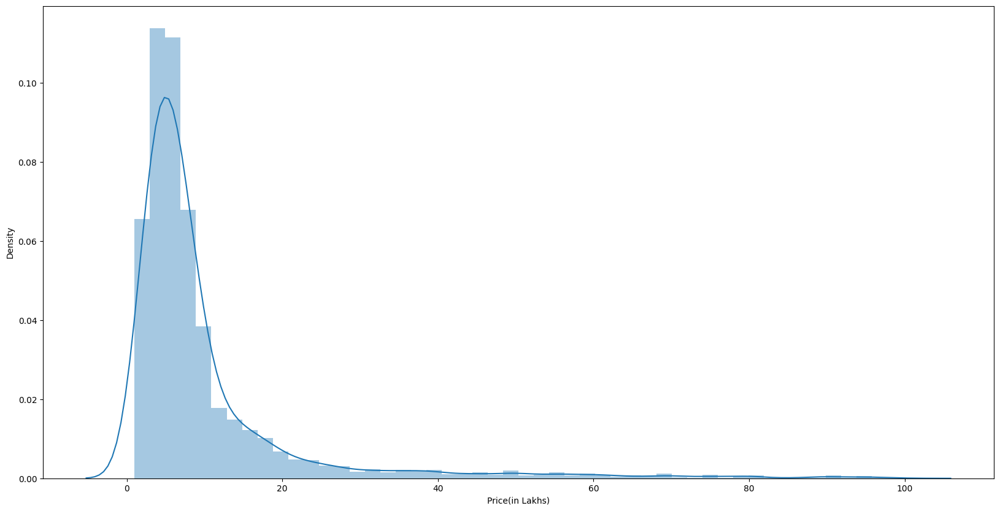

In [86]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize = [20,10])

sns.distplot(new_car_details_df['Price(in Lakhs)'])
plt.show()

In [87]:
Q1 =  new_car_details_df['Price(in Lakhs)'].quantile(0.25)
Q3 =  new_car_details_df['Price(in Lakhs)'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = new_car_details_df[(new_car_details_df['Price(in Lakhs)'] < lower_bound) | (new_car_details_df['Price(in Lakhs)'] > upper_bound)]
print(f"Number of outliers: {len(outliers)}")


Number of outliers: 920


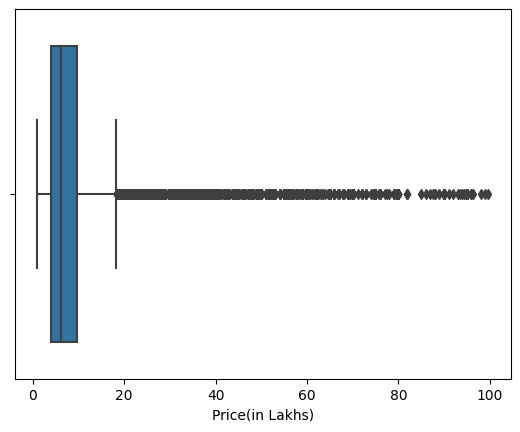

In [88]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.boxplot(x=new_car_details_df['Price(in Lakhs)'])
plt.show()


In [89]:
import numpy as np
new_car_details_df['Price(in Lakhs)'] = np.sqrt(new_car_details_df['Price(in Lakhs)'])


C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


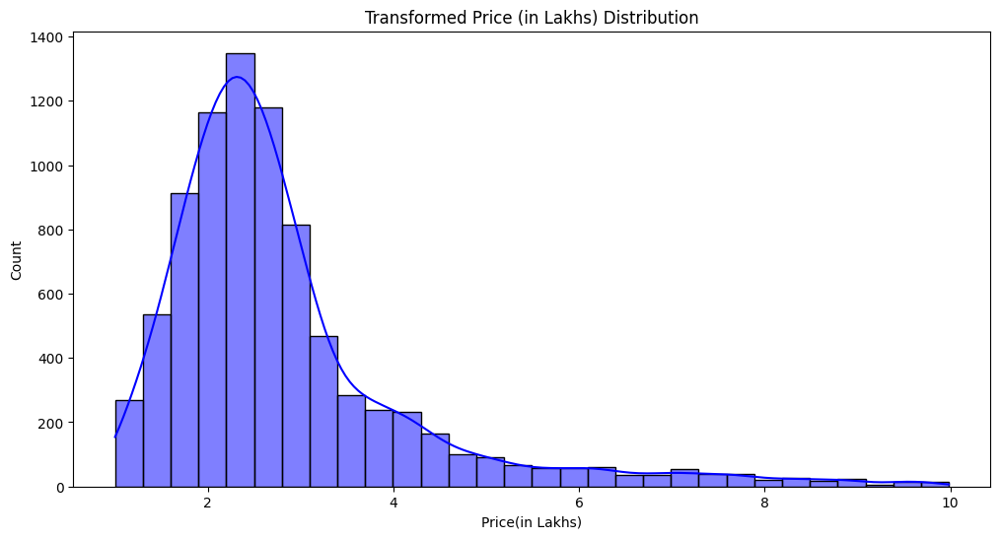

In [90]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6)) 
sns.histplot(new_car_details_df['Price(in Lakhs)'], kde=True, bins=30, color='blue')
plt.title('Transformed Price (in Lakhs) Distribution')
plt.show()

In [91]:
Q1 =  new_car_details_df['Price(in Lakhs)'].quantile(0.25)
Q3 =  new_car_details_df['Price(in Lakhs)'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Cap the outliers
new_car_details_df['Price(in Lakhs)'] = new_car_details_df['Price(in Lakhs)'].clip(lower=lower_bound, upper=upper_bound)


In [92]:
Q1 =  new_car_details_df['Price(in Lakhs)'].quantile(0.25)
Q3 =  new_car_details_df['Price(in Lakhs)'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = new_car_details_df[(new_car_details_df['Price(in Lakhs)'] < lower_bound) | (new_car_details_df['Price(in Lakhs)'] > upper_bound)]
print(f"Number of outliers: {len(outliers)}")


Number of outliers: 0


C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


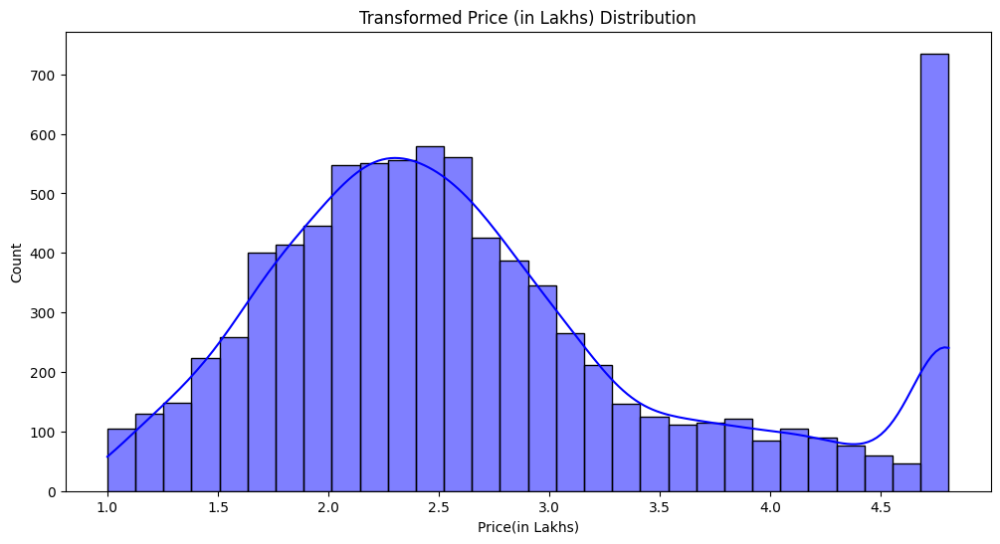

In [93]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6)) 
sns.histplot(new_car_details_df['Price(in Lakhs)'], kde=True, bins=30, color='blue')
plt.title('Transformed Price (in Lakhs) Distribution')
plt.show()

right-skewed  presence of outliers on the higher end of the column Price (in Lakhs).
We have applied square root transformation to reduce the outliers.
The outliers were brought from 920 to 681 through this method.
Then we replaced the extreme values (outliers) with the boundary values defined by the IQR method.
Later we have observed that all the outliers have been treated.

##  Exploratory Data Analysis

In [94]:
new_car_details_df.describe()

,bt,transmission,ownerNo,oem,model,Price(in Lakhs),Distance(in KM),ft_Cng,ft_Diesel,ft_Electric,ft_Lpg,ft_Petrol,City_Bangalore,City_Chennai,City_Delhi,City_Hyderabad,City_Jaipur,City_Kolkata,car_age
count,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000,8.369000e+03,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000,8369.000000
mean,10.018054,0.276855,1.360139,10.018054,163.954475,2.690392,5.897430e+04,0.011710,0.319393,0.003346,0.001912,0.663640,0.176963,0.169554,0.177441,0.177202,0.133827,0.165014,8.496714
std,4.102391,0.447471,0.641958,7.667955,97.458587,0.974860,7.406100e+04,0.107583,0.466269,0.057748,0.043685,0.472492,0.381660,0.375263,0.382064,0.381862,0.340487,0.371215,3.921465
min,3.822500,0.000000,0.000000,2.850000,20.000000,1.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
25%,6.013670,0.000000,1.000000,6.546887,88.000000,2.000000,3.000000e+04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000
50%,10.727985,0.000000,1.000000,6.946372,140.000000,2.487971,5.369200e+04,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000
75%,15.327960,1.000000,2.000000,9.660603,250.000000,3.122499,8.000000e+04,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,11.000000
max,82.000000,1.000000,5.000000,73.333333,370.000000,4.806247,5.500000e+06,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,40.000000


In [95]:

num_cols = ['Price(in Lakhs)','Distance(in KM)','model','ft_Cng','ft_Diesel','ft_Electric','ft_Lpg','ft_Petrol'	,'bt','transmission','ownerNo']

C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

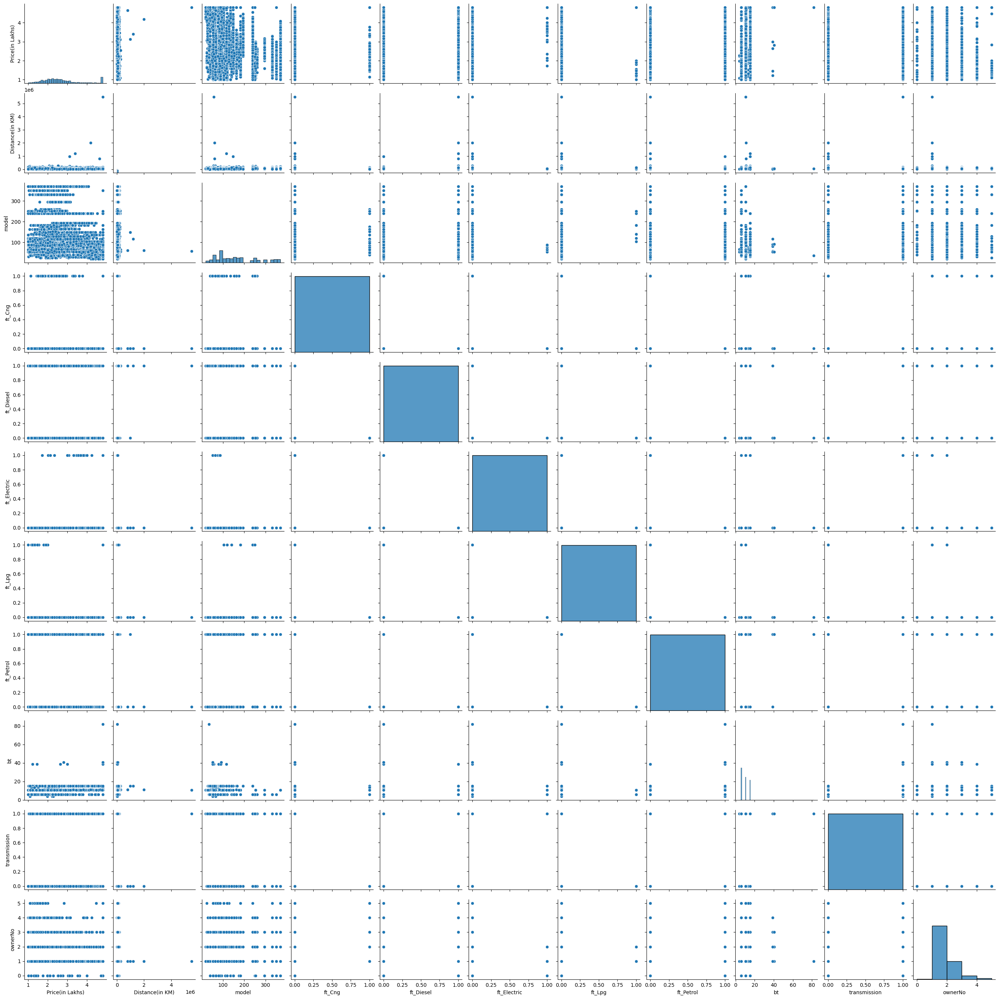

In [97]:
sns.pairplot(new_car_details_df[num_cols])
plt.show()

C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


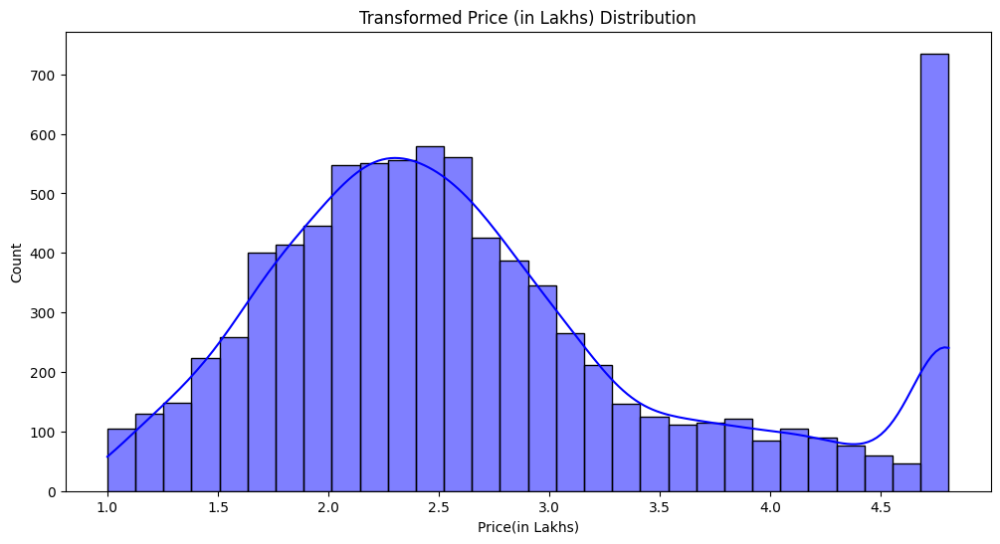

In [98]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6)) 
sns.histplot(new_car_details_df['Price(in Lakhs)'], kde=True, bins=30, color='blue')
plt.title('Transformed Price (in Lakhs) Distribution')
plt.show()

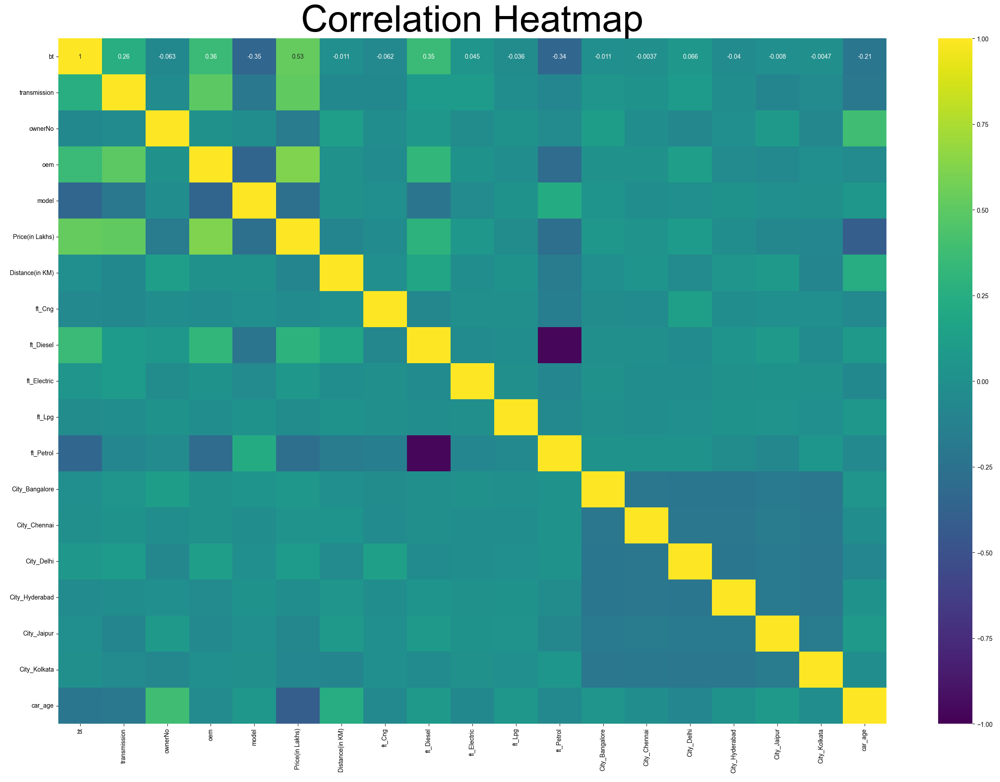

In [99]:
# Select only numeric columns
numeric_df = new_car_details_df
#.select_dtypes(include=['number'])
plt.figure(figsize=(30, 20))
sns.heatmap(numeric_df.corr(), cmap='viridis', annot=True, annot_kws={"size": 10}, vmin=-1, vmax=1)
sns.set(font_scale=5)
plt.title("Correlation Heatmap")
plt.show()


In [100]:

numeric_df.corr()

,bt,transmission,ownerNo,oem,model,Price(in Lakhs),Distance(in KM),ft_Cng,ft_Diesel,ft_Electric,ft_Lpg,ft_Petrol,City_Bangalore,City_Chennai,City_Delhi,City_Hyderabad,City_Jaipur,City_Kolkata,car_age
bt,1.000000,0.256887,-0.063323,0.358961,-0.349977,0.525732,-0.010743,-0.061989,0.353786,0.044602,-0.036436,-0.337095,-0.011372,-0.003650,0.066286,-0.039678,-0.007955,-0.004729,-0.214773
transmission,0.256887,1.000000,-0.046777,0.493275,-0.197942,0.510067,-0.065439,-0.067352,0.092769,0.093639,-0.027080,-0.085152,0.040569,0.022163,0.092177,-0.023482,-0.092615,-0.049883,-0.196946
ownerNo,-0.063323,-0.046777,1.000000,0.001794,-0.019396,-0.166478,0.115419,-0.024733,0.055634,-0.032506,0.018058,-0.046967,0.109077,-0.029286,-0.072016,-0.015154,0.085095,-0.070884,0.390012
oem,0.358961,0.493275,0.001794,1.000000,-0.355706,0.610387,0.002958,-0.041669,0.316307,0.022275,-0.016884,-0.303815,0.000563,0.004895,0.112471,-0.052693,-0.056121,-0.015606,-0.049620
model,-0.349977,-0.197942,-0.019396,-0.355706,1.000000,-0.272669,0.005199,-0.010788,-0.220888,-0.053884,0.014420,0.225687,0.031705,-0.017280,-0.012980,0.011825,-0.014719,-0.000433,0.060787
Price(in Lakhs),0.525732,0.510067,-0.166478,0.610387,-0.272669,1.000000,-0.086839,-0.040358,0.286941,0.059406,-0.035800,-0.277924,0.060576,0.027190,0.086779,-0.023766,-0.075055,-0.085791,-0.406860
Distance(in KM),-0.010743,-0.065439,0.115419,0.002958,0.005199,-0.086839,1.000000,-0.009538,0.173940,-0.024657,0.013513,-0.167713,-0.009918,0.031814,-0.047121,0.043142,0.079835,-0.091073,0.245030
ft_Cng,-0.061989,-0.067352,-0.024733,-0.041669,-0.010788,-0.040358,-0.009538,1.000000,-0.074567,-0.006307,-0.004764,-0.152897,-0.033011,-0.040305,0.120977,-0.024335,-0.010163,-0.015474,-0.061376
ft_Diesel,0.353786,0.092769,0.055634,0.316307,-0.220888,0.286941,0.173940,-0.074567,1.000000,-0.039690,-0.029981,-0.962229,-0.006058,-0.007662,-0.045145,0.037814,0.073978,-0.046315,0.079297
ft_Electric,0.044602,0.093639,-0.032506,0.022275,-0.053884,0.059406,-0.024657,-0.006307,-0.039690,1.000000,-0.002536,-0.081383,0.005666,-0.020666,-0.016077,0.005627,0.019770,0.007691,-0.069081


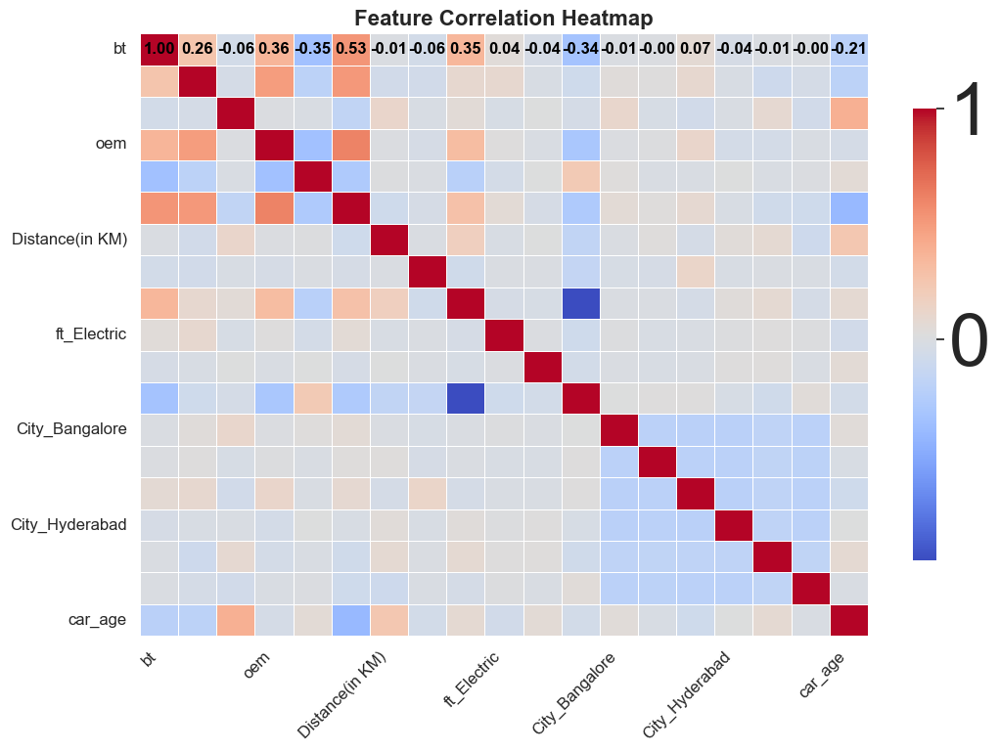

In [126]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load dataset
df = pd.read_csv("Finaldata.csv")  # Update filename if needed

# Compute correlation matrix
corr_matrix = df.corr()

# Set figure size
plt.figure(figsize=(12, 8))

# Create heatmap with forced annotation properties
ax = sns.heatmap(
    corr_matrix, 
    annot=True,  # Ensure annotations are enabled
    cmap="coolwarm", 
    fmt=".2f",  # Format numbers to 2 decimal places
    linewidths=0.5, 
    annot_kws={"size": 12, "color": "black", "weight": "bold"},  # Force text visibility
    cbar_kws={"shrink": 0.75}  # Shrink color bar
)

# Manually set annotation positions
for text in ax.texts:
    text.set_ha("center")  # Horizontally center text
    text.set_va("center")  # Vertically center text
    text.set_fontsize(12)  # Set readable font size
    text.set_weight("bold")  # Make text bold for visibility
    text.set_color("black")  # Ensure text color is visible

# Adjust title and labels
plt.title("Feature Correlation Heatmap", fontsize=16, fontweight="bold")
plt.xticks(fontsize=12, rotation=45, ha="right")
plt.yticks(fontsize=12)

# Show plot
plt.show()


C:\Users\User\anaconda3\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)


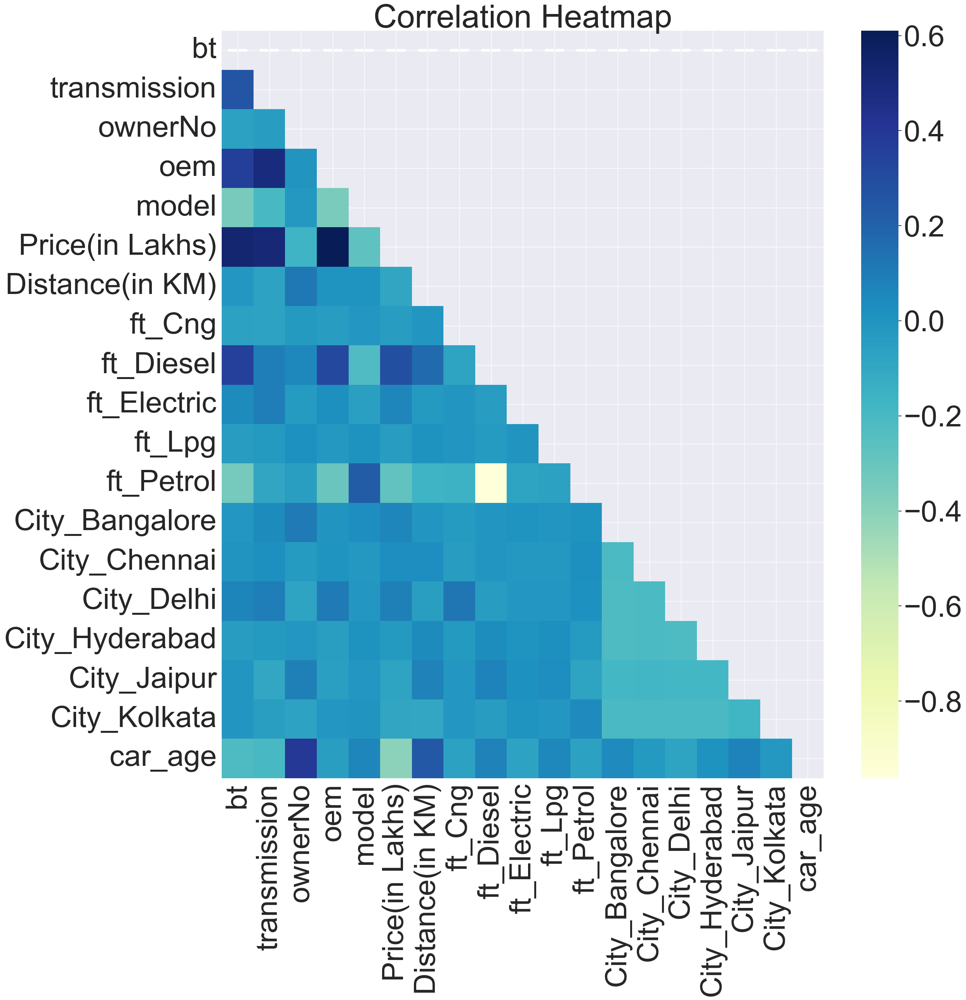

In [101]:
plt.figure(figsize=(25,25))
plt.title("Correlation Heatmap")
# creating mask 
mask = np.triu(np.ones_like(numeric_df.corr())) 
dataplot = sns.heatmap(numeric_df.corr(), cmap="YlGnBu", annot=True, mask=mask)
plt.show()



### Positive Correlations
* **Moderate Correlation Between "bt" and "Distance (in KM)" (0.36)**
    * This suggests that the target variable (likely "bt") increases as the distance increases.
* **Negative Correlation Between "bt" and "car_age" (-0.21)**
    * Older cars tend to have lower "bt" values, which could indicate depreciation.
* **Weak Correlation Between "bt" and Fuel Type or Cities**
    * The impact of categorical variables like city and fuel type on "bt" seems minimal.
*  **Strong Correlations Among Categorical Variables**
    * Features like "City_Bangalore" and "City_Hyderabad" are mostly independent of numerical ones.


### Negative Correlations
* **Transmission Type (transmission) and Price:**
    * Manual transmission cars are generally less expensive than automatic transmission cars.
* **Model Year and Price:**
    * Newer models tend to be more expensive when they are first released, but their price decreases over time due to depreciation.

## Normalization of Numerical Data using Min-Max Scaling

In [102]:
from sklearn.preprocessing import MinMaxScaler

# Instantiate the MinMaxScaler
scaler = MinMaxScaler()

# Select the columns you want to scale
columns_to_scale = ['bt', 'oem', 'model', 'car_age', 'Distance(in KM)']

# Apply Min-Max scaling to the selected columns
new_car_details_df[columns_to_scale] = scaler.fit_transform(new_car_details_df[columns_to_scale])

# Store min and max values for potential inverse transformation
dis_min, dis_max = new_car_details_df['Distance(in KM)'].min(), new_car_details_df['Distance(in KM)'].max()
year_min, year_max = new_car_details_df['car_age'].min(), new_car_details_df['car_age'].max()

# Display the scaled data
print(new_car_details_df[columns_to_scale].head())


         bt       oem     model   car_age  Distance(in KM)
0  0.028028  0.058118  0.888571  0.210526         0.021818
1  0.028028  0.052451  0.942857  0.289474         0.012173
2  0.028028  0.052451  0.377143  0.184211         0.014545
3  0.028028  0.058118  0.685714  0.157895         0.008071
4  0.028028  0.052451  0.657143  0.184211         0.007273


In [176]:
import joblib
from sklearn.preprocessing import MinMaxScaler

# Instantiate the MinMaxScaler
scaler = MinMaxScaler()

# Select the columns you want to scale
columns_to_scale = ['bt', 'oem', 'model', 'car_age', 'Distance(in KM)']

# Apply Min-Max scaling
new_car_details_df[columns_to_scale] = scaler.fit_transform(new_car_details_df[columns_to_scale])

# Save the scaler to a file
joblib.dump(scaler, 'scaler.pkl')

# Store min and max values for inverse transformation
scaler_metadata = {
    'dis_min': new_car_details_df['Distance(in KM)'].min(),
    'dis_max': new_car_details_df['Distance(in KM)'].max(),
    'year_min': new_car_details_df['car_age'].min(),
    'year_max': new_car_details_df['car_age'].max()
}

# Save the metadata
joblib.dump(scaler_metadata, 'scaler_metadata.pkl')

print("Scaler and metadata saved successfully!")


Scaler and metadata saved successfully!


C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

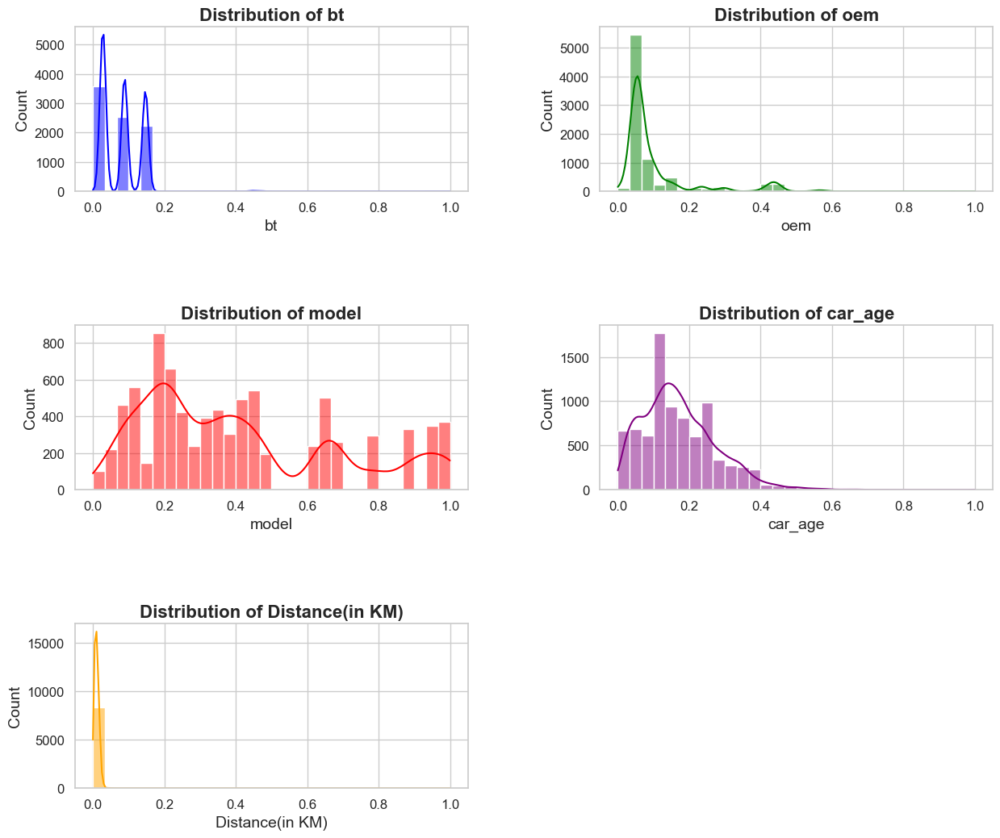

In [113]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set Seaborn style for a clean look
sns.set_style("whitegrid")

# Define figure size and number of subplots (adjusting for better spacing)
fig, axes = plt.subplots(3, 2, figsize=(14, 12))  # 3 rows, 2 columns for better layout

# Flatten axes array for easier iteration
axes = axes.flatten()

# Column names to plot
columns_to_scale = ['bt', 'oem', 'model', 'car_age', 'Distance(in KM)']

# Colors for different plots
colors = ['blue', 'green', 'red', 'purple', 'orange']

# Generate histograms with proper sizing and labels
for i, col in enumerate(columns_to_scale):
    sns.histplot(new_car_details_df[col], bins=30, kde=True, color=colors[i], ax=axes[i])
    axes[i].set_title(f"Distribution of {col}", fontsize=16, fontweight='bold')
    axes[i].set_xlabel(col, fontsize=14)
    axes[i].set_ylabel("Count", fontsize=14)
    axes[i].tick_params(axis='both', labelsize=12)
    axes[i].grid(True)

# Remove any empty subplot (if fewer plots than subplots)
if len(columns_to_scale) < len(axes):
    for j in range(len(columns_to_scale), len(axes)):
        fig.delaxes(axes[j])

# Adjust layout for clear visualization
plt.tight_layout()
plt.show()




### Distributions
* **"bt" Distribution**
    * The distribution is skewed towards the left with multiple peaks, suggesting that most values are      concentrated around lower values. This could indicate that "bt" is affected by certain categorical      factors.
* **"oem" Distribution**
    * The "oem" variable has a right-skewed distribution, meaning most values are small, with a few         larger values. This could indicate that a few manufacturers dominate the dataset.
* **"model" Distribution**
    * The "model" feature appears more evenly spread across different values, though it still has            peaks. The distribution suggests that certain car models are more common in the dataset.
*  **"car_age" Distribution**
    * The "car_age" feature follows a right-skewed distribution, indicating that there are more newer        cars in the dataset compared to older ones.
*  **"Distance (in KM)" Distribution**
    * This feature has a highly skewed distribution, where most cars have traveled a lower distance.        This suggests that the dataset includes a majority of low-mileage vehicles, which may impact            predictions.

C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
C:\Users\User\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating ins

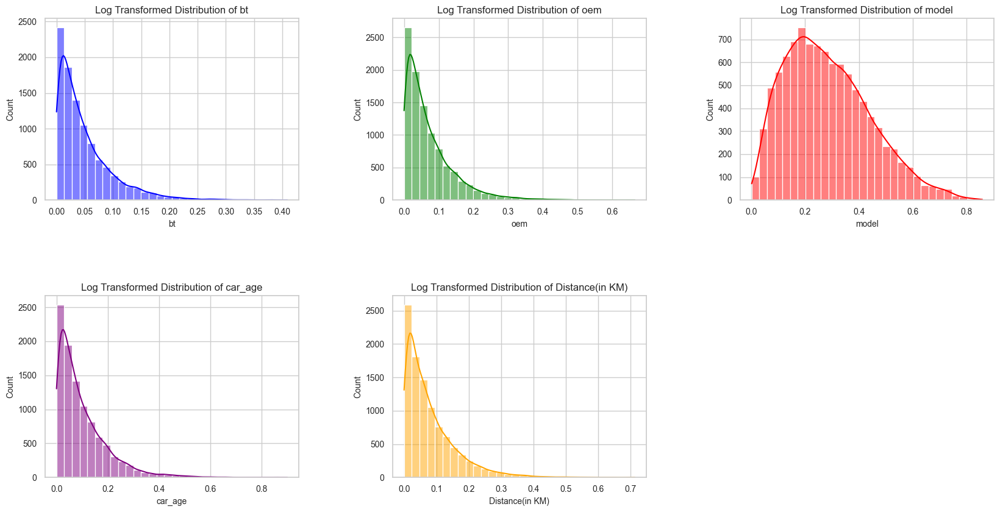

In [117]:
import matplotlib.pyplot as plt
import seaborn as sns

# Adjust figure size
fig, axes = plt.subplots(2, 3, figsize=(18, 10))
axes = axes.flatten()

columns = ["bt", "oem", "model", "car_age", "Distance(in KM)"]
colors = ["blue", "green", "red", "purple", "orange"]

for i, col in enumerate(columns):
    sns.histplot(df[col], kde=True, color=colors[i], ax=axes[i], bins=30)
    
    # Adjust font sizes
    axes[i].set_title(f"Log Transformed Distribution of {col}", fontsize=12)
    axes[i].set_xlabel(col, fontsize=10)
    axes[i].set_ylabel("Count", fontsize=10)
    
    # Fix overly large tick labels
    axes[i].tick_params(axis='both', labelsize=10)

# Remove the extra empty subplot if present
if len(columns) < len(axes):
    fig.delaxes(axes[-1])

plt.tight_layout()  # Prevents text overlap
plt.show()


##  Model Development

In [128]:
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.svm import SVR
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import ExtraTreesRegressor, RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, explained_variance_score, r2_score

In [129]:
X=new_car_details_df.drop('Price(in Lakhs)',axis=1)      # Feature Matrix
X

,bt,transmission,ownerNo,oem,model,Distance(in KM),ft_Cng,ft_Diesel,ft_Electric,ft_Lpg,ft_Petrol,City_Bangalore,City_Chennai,City_Delhi,City_Hyderabad,City_Jaipur,City_Kolkata,car_age
0,0.028028,0,2,0.058118,0.888571,0.021818,0,1,0,0,0,0,0,0,0,1,0,0.210526
1,0.028028,0,1,0.052451,0.942857,0.012173,0,0,0,0,1,0,0,0,0,1,0,0.289474
2,0.028028,1,2,0.052451,0.377143,0.014545,0,0,0,0,1,0,0,0,0,1,0,0.184211
3,0.028028,0,1,0.058118,0.685714,0.008071,0,0,0,0,1,0,0,0,0,1,0,0.157895
4,0.028028,1,1,0.052451,0.657143,0.007273,0,0,0,0,1,0,0,0,0,1,0,0.184211
5,0.088331,0,2,0.058118,0.462857,0.027273,0,1,0,0,0,0,0,0,0,1,0,0.421053
6,0.088331,0,2,0.058118,0.094286,0.016686,0,0,0,0,1,0,0,0,0,1,0,0.184211
7,0.088331,1,1,0.100002,0.014286,0.016364,0,1,0,0,0,0,0,0,0,1,0,0.315789
8,0.147171,1,1,0.429053,0.037143,0.010658,0,1,0,0,0,0,0,0,0,1,0,0.236842
9,0.088331,1,1,0.100002,0.014286,0.016364,0,1,0,0,0,0,0,0,0,1,0,0.315789


In [130]:
y=new_car_details_df['Price(in Lakhs)']    # Target Variable
y

0       2.258318
1       1.951922
2       1.788854
3       2.049390
4       1.870829
5       1.224745
6       2.211334
7       2.061553
8       3.708099
9       2.121320
10      1.870829
11      2.118962
12      1.717556
13      4.806247
14      1.024695
15      4.460942
16      2.179449
17      4.472136
18      3.000000
19      3.082207
20      4.358899
21      2.088061
22      3.162278
23      1.587451
24      2.617250
25      2.345208
26      2.643861
27      2.738613
28      1.802776
29      3.605551
30      4.743416
31      4.806247
32      1.936492
33      2.366432
34      2.428992
35      2.355844
36      4.806247
37      4.806247
38      2.449490
39      1.303840
40      1.852026
41      2.332381
42      3.146427
43      2.165641
44      2.675818
45      3.162278
46      1.224745
47      1.746425
48      2.345208
49      3.605551
50      1.702939
51      2.345208
52      1.449138
53      3.016621
54      1.500000
55      2.692582
56      2.387467
57      3.464102
58      2.6851

## Feature Selection

In [131]:
from sklearn.ensemble import ExtraTreesRegressor

model = ExtraTreesRegressor()

print(model.fit(X,y))
ExtraTreesRegressor()

ExtraTreesRegressor()


ExtraTreesRegressor()

In [132]:
print('-'*50)
print('Checking for feature importance')
print('-'*50)

print(model.feature_importances_)

--------------------------------------------------
Checking for feature importance
--------------------------------------------------
[0.14965598 0.22133096 0.02270522 0.20919901 0.07219855 0.04379041
 0.00109266 0.00965122 0.0004299  0.00158829 0.0380681  0.011763
 0.00554855 0.00927902 0.00515972 0.00932782 0.00972155 0.17949003]


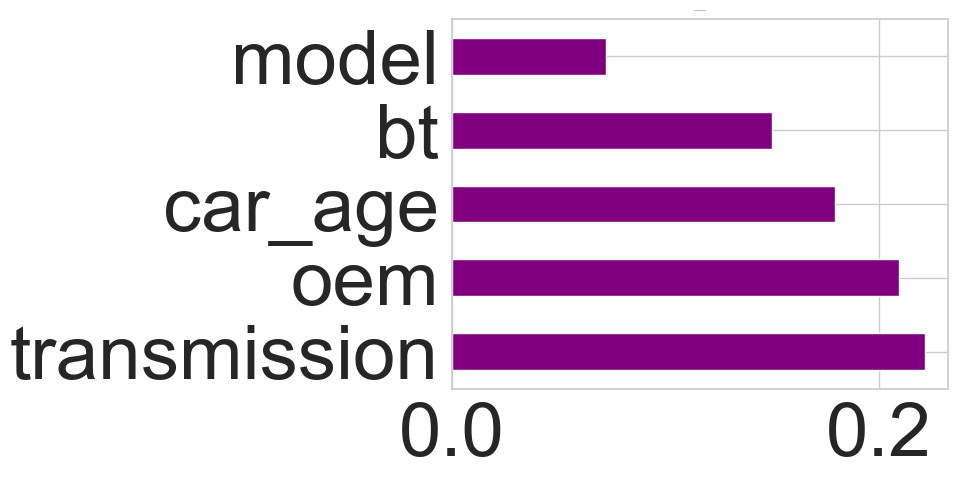

In [133]:
imp_feature = pd.Series(model.feature_importances_, index = X.columns)
imp_feature.nlargest(5).plot(kind = 'barh', color='purple')
plt.title('Important Features', fontsize=0)
plt.show()

## Model Selection,Model Training and Model Evaluation

In [134]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [135]:
models = [ LinearRegression, SVR, DecisionTreeRegressor, RandomForestRegressor]
mae=[]
mse = []
rmse = []
evs = []
r_square_score = []

for model in models:
    regressor = model().fit(X_train, y_train)
    pred = regressor.predict(X_test)
    mae.append(mean_absolute_error(y_true=y_test, y_pred=pred))
    mse.append(mean_squared_error(y_true= y_test, y_pred= pred))
    rmse.append(np.sqrt(mean_squared_error(y_true= y_test, y_pred= pred)))
    evs.append(explained_variance_score(y_true= y_test, y_pred= pred))
    r_square_score.append(r2_score(y_true= y_test, y_pred= pred))

In [136]:
ML_model_df=pd.DataFrame({"Model":[ 'Linear Regression', 'Support Vector Rregression', 'Decision Tree Regressor', \
                                   'Random Forest Regressor'],
                         "Mean Absolute Error":mae,
                         "Mean Squarred Error":mse,
                         "Root Mean Squarred Error":rmse,
                         "Explained Variance Score":evs,
                         "R-Sqaure Score(Accuracy)":r_square_score})

ML_model_df.set_index('Model',inplace=True)
ML_model_df

,Mean Absolute Error,Mean Squarred Error,Root Mean Squarred Error,Explained Variance Score,R-Sqaure Score(Accuracy)
Model,,,,,
Linear Regression,0.357343,0.332139,0.576315,0.635294,0.634674
Support Vector Rregression,0.307023,0.302157,0.549688,0.669482,0.667651
Decision Tree Regressor,0.248871,0.296576,0.544588,0.674205,0.673790
Random Forest Regressor,0.204743,0.169858,0.412138,0.813970,0.813170


 Random Forest Regressor is the best performer:

It has the lowest values for Mean Absolute Error (MAE) (0.204743), Mean Squared Error (MSE) (0.169858), and Root Mean Squared Error (RMSE) (0.412138). These metrics indicate the average difference between the predicted and actual values, with lower values indicating better performance.
It has the highest values for Explained Variance Score (0.813970) and R-squared Score (0.813170).

## Hyperparameter Tuning

In [137]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor

In [138]:
param_grid = {
    'n_estimators': [100, 200, 300],
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}
# Create a Random Forest Regressor
rf = RandomForestRegressor(random_state=42)

# Create a GridSearchCV object
grid_search = GridSearchCV(estimator=rf, param_grid=param_grid, cv=5, n_jobs=-1, verbose=2)

# Fit the GridSearchCV object to the training data
grid_search.fit(X_train, y_train)

# Print the best parameters and best score
print("Best parameters:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)

# Use the best model to make predictions
best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

Fitting 5 folds for each of 108 candidates, totalling 540 fits
Best parameters: {'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
Best score: 0.8150077467092596


## Model Performance Comparison

### Random Forest Regressor
* **Overall Best Performer:** Excels across all metrics.
* **High Accuracy:** Low error rates (MAE, MSE, RMSE) indicate precise predictions.
* **Strong Explanatory Power:** Captures a significant portion of the data's variance.

### Decision Tree Regressor
* **Reasonable Performance:** Performs adequately but falls short of Random Forest.
* **Moderate Accuracy:** Moderate error rates.
* **Moderate Explanatory Power:** Captures a moderate portion

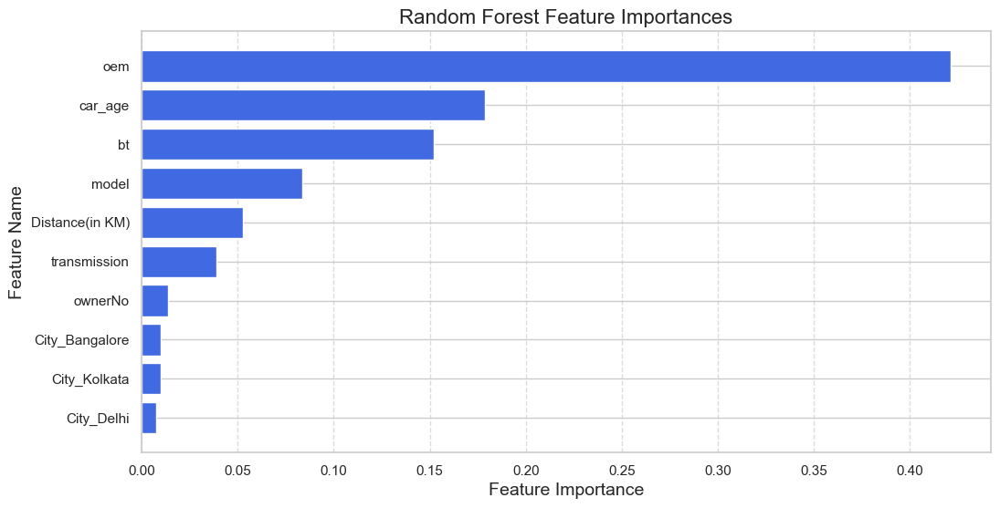

In [144]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# Assuming 'rf_best' is your trained Random Forest model
feature_importances = best_model.feature_importances_
feature_names = X_train.columns  

# Create DataFrame
importance_df = pd.DataFrame({'Feature': feature_names, 'Importance': feature_importances})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Limit to top 10 features
top_n = 10
importance_df = importance_df.iloc[:top_n]

# Seaborn styling
sns.set(style="whitegrid")

# Plot feature importances
plt.figure(figsize=(12, 6))
plt.barh(importance_df['Feature'], importance_df['Importance'], color='royalblue')
plt.xlabel("Feature Importance", fontsize=14)
plt.ylabel("Feature Name", fontsize=14)
plt.title("Random Forest Feature Importances", fontsize=16)
plt.gca().invert_yaxis()  # Invert y-axis for better readability

# Add grid lines
plt.grid(axis='x', linestyle='--', alpha=0.7)

plt.show()


oem (Original Equipment Manufacturer) is by far the most important feature:

It has a significantly higher importance score (around 0.42) compared to all other features, indicating it plays a dominant role in the model's predictions. This suggests that the brand or manufacturer of the car is the strongest predictor of the target variable (which we don't know from the image, but could be something like price, fuel efficiency, or likelihood of breakdown).
2. car_age and bt (likely Battery Type or Bluetooth, without more context) are moderately important:

They have similar importance scores (around 0.16-0.17), making them the second and third most influential features respectively. car_age suggests that the age of the vehicle is a significant factor, which is logical in many car-related predictions.
3. model has a noticeable, but lesser importance:

It scores around 0.08, indicating that the specific model contributes to the prediction, but less so than oem, car_age, and bt.
4. Distance(in KM) and transmission have some importance:

They have scores around 0.04-0.05, suggesting they provide some predictive power, but are considerably less influential than the top features.
5. ownerNo (Number of Previous Owners) and the City indicators have very low importance:

These features have importance scores close to zero. This implies they have little to no impact on the model's predictions. For example, whether a car was sold in Bangalore, Kolkata, or Delhi doesn't seem to be a strong predictor in this model. Similarly, the number of previous owners might not be as relevant as other factors.

In [145]:
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

# Predict on test data
y_pred = best_model.predict(X_test)

# Compute metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# Print results
print(f"Test Mean Absolute Error: {mae:.4f}")
print(f"Test Mean Squared Error: {mse:.4f}")
print(f"Test Root Mean Squared Error: {rmse:.4f}")
print(f"Test R² Score: {r2:.4f}")


Test Mean Absolute Error: 0.2057
Test Mean Squared Error: 0.1697
Test Root Mean Squared Error: 0.4120
Test R² Score: 0.8133


In [146]:
from sklearn.linear_model import Lasso

# Create a Lasso regression model with a specific alpha value
lasso_model = Lasso(alpha=0.1)  # Adjust alpha to control regularization strength

# Fit the model to your training data
lasso_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = lasso_model.predict(X_test)

In [147]:
from sklearn.linear_model import Ridge

# Create a Ridge regression model with a specific alpha value
ridge_model = Ridge(alpha=0.1)  # Adjust alpha to control regularization strength

# Fit the model to your training data
ridge_model.fit(X_train, y_train)

# Make predictions on the test data
y_pred = ridge_model.predict(X_test)

In [148]:
lasso_pred = lasso_model.predict(X_test)
ridge_pred = ridge_model.predict(X_test)

from sklearn.metrics import mean_squared_error

mse_lasso = mean_squared_error(y_test, lasso_pred)
mse_ridge = mean_squared_error(y_test, ridge_pred)

print("Mean Squared Error for Lasso:", mse_lasso)
print("Mean Squared Error for Ridge:", mse_ridge)

Mean Squared Error for Lasso: 0.7012335878541028
Mean Squared Error for Ridge: 0.33199541601128224


## Model Comparison: Ridge vs Lasso Regression

**Mean Squared Error (MSE):**

* **Ridge Regression:** Lower MSE, indicating better predictive performance.
* **Lasso Regression:** Higher MSE, suggesting less accurate predictions.

**Interpretation:**

Ridge regression's lower MSE implies that it is better at minimizing the average squared difference between predicted and actual values. This suggests that Ridge regression might be a more suitable model for this particular dataset, potentially due to its ability to handle multicollinearity and overfitting.

In [149]:
model=RandomForestRegressor()

In [150]:
model.fit(X_train,y_train)

RandomForestRegressor()

In [151]:
predict=model.predict(X_test)

In [152]:
X_test

,bt,transmission,ownerNo,oem,model,Distance(in KM),ft_Cng,ft_Diesel,ft_Electric,ft_Lpg,ft_Petrol,City_Bangalore,City_Chennai,City_Delhi,City_Hyderabad,City_Jaipur,City_Kolkata,car_age
648,0.028028,0,1,0.041757,0.057143,0.029984,0,0,0,0,1,0,0,0,0,1,0,0.210526
5694,0.088331,1,2,0.050272,1.000000,0.010415,0,0,0,0,1,1,0,0,0,0,0,0.157895
4917,0.147171,0,1,0.059306,0.205714,0.002876,0,0,0,0,1,0,1,0,0,0,0,0.026316
716,0.147171,0,1,0.098061,0.365714,0.008026,0,0,0,0,1,0,0,0,0,1,0,0.026316
1795,0.147171,0,1,0.164986,0.214286,0.010909,0,1,0,0,0,0,0,0,1,0,0,0.078947
6693,0.088331,0,4,0.117926,0.171429,0.015818,0,1,0,0,0,1,0,0,0,0,0,0.289474
7737,0.028028,0,1,0.058118,0.685714,0.015534,0,0,0,0,1,0,0,0,0,0,1,0.184211
389,0.147171,1,3,0.058118,0.497143,0.001121,0,0,0,0,1,0,0,0,0,1,0,0.052632
5569,0.028028,0,2,0.058118,0.182857,0.018182,0,0,0,0,1,1,0,0,0,0,0,0.447368
1569,0.028028,0,1,0.058118,0.088571,0.003636,0,0,0,0,1,0,0,0,1,0,0,0.052632


In [153]:
predict

array([2.02846062, 3.03101229, 3.965401  , ..., 1.58293645, 2.1977574 ,
       2.00788628], shape=(1674,))

In [154]:
X_train.head(1)

,bt,transmission,ownerNo,oem,model,Distance(in KM),ft_Cng,ft_Diesel,ft_Electric,ft_Lpg,ft_Petrol,City_Bangalore,City_Chennai,City_Delhi,City_Hyderabad,City_Jaipur,City_Kolkata,car_age
7345,0.028028,0,1,0.052451,0.082857,0.001255,0,0,0,0,1,0,0,0,0,0,1,0.026316


In [155]:
input_data_model=pd.DataFrame(
    [[3500,5.0,1,3,45000,60230,0,1,0,0,0,1,0,0,0,0,0,5]]
)

In [159]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler

# List of expected features from the trained model
expected_features = best_model.feature_names_in_

# Define input data
input_data = pd.DataFrame(
    [[3500, 5.0, 1, 3, 45000, 60230, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 5]],
    columns=['bt', 'oem', 'model', 'car_age', 'Distance(in KM)', 'extra_1', 'extra_2', 
             'extra_3', 'extra_4', 'extra_5', 'extra_6', 'extra_7', 'extra_8', 
             'extra_9', 'extra_10', 'extra_11', 'extra_12', 'extra_13']
)

# Ensure all expected columns exist in input data
for col in expected_features:
    if col not in input_data.columns:
        input_data[col] = 0  # Add missing columns with default value 0

# Keep only the columns that were used during training
input_data = input_data[expected_features]

# Apply MinMax Scaling to required columns (use same scaler from training)
columns_to_scale = ['bt', 'oem', 'model', 'car_age', 'Distance(in KM)']
input_data[columns_to_scale] = scaler.transform(input_data[columns_to_scale])

# Make predictions
prediction = best_model.predict(input_data)

# Print results
print("Predicted Output:", prediction)


Predicted Output: [3.58883213]


In [156]:
model.predict(input_data_model)

C:\Users\User\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but RandomForestRegressor was fitted with feature names
  warnings.warn(


array([3.88343235])

In [177]:
import joblib

# Save the trained model (replace 'best_model' with your model variable)
joblib.dump(best_model, 'car_price_model.joblib')

print("Model saved successfully!")


Model saved successfully!


In [161]:
import joblib
joblib.dump((best_model, list(X_train.columns), scaler), 'car_price_model.pkl')


['car_price_model.pkl']

In [178]:
loaded_data = joblib.load("car_price_model.pkl")
print(type(loaded_data), loaded_data)


<class 'tuple'> (RandomForestRegressor(max_depth=20, n_estimators=300, random_state=42), ['bt', 'transmission', 'ownerNo', 'oem', 'model', 'Distance(in KM)', 'ft_Cng', 'ft_Diesel', 'ft_Electric', 'ft_Lpg', 'ft_Petrol', 'City_Bangalore', 'City_Chennai', 'City_Delhi', 'City_Hyderabad', 'City_Jaipur', 'City_Kolkata', 'car_age'], MinMaxScaler())
